In [ ]:
import pandas as pd
import os
import numpy as np

In [2]:
!dir

 驱动器 G 中的卷没有标签。
 卷的序列号是 10DE-CC9B

 G:\mission\python\July_August\商品分析 的目录

2024/08/15  01:43    <DIR>          .
2024/08/13  10:15    <DIR>          ..
2024/08/13  10:29    <DIR>          dataset
2024/08/15  01:43            57,163 demo.ipynb
2024/08/14  19:51             1,565 demo.py
2024/08/14  16:41         1,665,578 final.xlsx
2024/08/14  23:48         3,562,902 llm_out.ipynb
2024/08/14  19:51    <DIR>          logs
2024/08/14  23:44       112,250,515 results.json
2024/08/15  01:26        36,138,578 vllm.ipynb
               6 个文件    153,676,301 字节
               4 个目录 178,571,821,056 可用字节


In [91]:
jingdong_path = "./dataset/京东评论/"
jingdong_list = os.listdir(jingdong_path)
jingdong_files = [jingdong_path + find_file for find_file in jingdong_list]
print(jingdong_list)
data_jingdong_dfs = [pd.read_excel(path) for path in jingdong_files]

['京东商品评论卫生巾（苏菲，abc，七度空间，护舒宝）.xlsx', '京东商品评论卫生棉条ob.xlsx', '京东商品评论卫生棉条丹碧丝.xlsx', '京东商品评论卫生棉条苏菲.xlsx', '京东商品评论安心裤ABC.xlsx', '京东商品评论安心裤七度空间.xlsx', '京东商品评论安心裤护舒宝.xlsx', '京东商品评论安心裤苏菲.xlsx', '京东商品评论液体卫生巾护舒宝.xlsx']


In [92]:
def f(text):
    text = str(text).lower()
    keywords = {
        '苏菲': '苏菲',
        'abc': 'ABC',
        '七度空间': '七度空间',
        '丹碧丝': '丹碧丝',
        'ob': 'ob',
        '护舒宝': '护舒宝',
        '安尔乐': '安尔乐',
    }

    for key, value in keywords.items():
        if key in text:
            return value

    return '其他'

In [93]:
def category(text):
    text = str(text).lower()
    keywords = {
        '液体卫生巾': '液体卫生巾',
        '卫生棉条': '卫生棉条',
        '安心裤': '安心裤',
        '卫生巾': '卫生巾'
    }

    for key, value in keywords.items():
        if key in text:
            return value

    return '其他'


In [95]:
for i, df in enumerate(data_jingdong_dfs):
	df['来源平台'] = ['京东' for _ in range(len(df))]
	df['品牌名称'] = df['页面标题'].apply(f)
	df['品牌大类'] = df['页面标题'].apply(category)
	df['评论字数'] = df['评价内容'].apply(len)

	print(set(df['品牌名称'].tolist()))
	print(set(df['品牌大类'].tolist()))
	print("=" * 100)

{'苏菲', 'ABC', '七度空间', '护舒宝'}
{'卫生巾'}
{'ob'}
{'卫生棉条'}
{'丹碧丝'}
{'卫生棉条'}
{'苏菲'}
{'卫生棉条'}
{'ABC'}
{'卫生巾'}
{'七度空间'}
{'安心裤'}
{'护舒宝'}
{'安心裤'}
{'苏菲'}
{'安心裤'}
{'护舒宝'}
{'液体卫生巾'}


In [96]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.rcParams['font.sans-serif'] = ['KaiTi', 'SimHei', 'FangSong']  # Chinese font preference: KaiTi, SimHei, FangSong
plt.rcParams['font.size'] = 12  # Font size
plt.rcParams['axes.unicode_minus'] = False  # Display minus sign correctly for Chinese characters

In [97]:
def data_analysis(df):
    # Display the situation of data fields, such as data type, unique values, and the proportion of missing data.
    output = pd.DataFrame(columns = ["Column", "Data Type", "Unique values", "NaN"])

    for column in df.columns:
        output = pd.concat([output, pd.DataFrame(np.array([column, df[column].dtypes, len(df[column].unique()),
                                                           df[column].isna().sum() / df[column].shape[0]]).reshape(1, 4),
                                                 columns = ["Column", "Data Type", "Unique values", "NaN"])])

    return output

In [98]:
data_jingdong_dfs[0].head(10)

,会员,级别,评价星级,评价内容,时间,点赞数,评论数,追评时间,追评内容,商品属性,页面网址,页面标题,采集时间,评论字数,来源平台,品牌名称,品牌大类
0,庞***纠,PLUS会员,star5,夏天最怕来姨妈了，真的闷热！所以挑选卫生巾也要好好挑选，我第一次用的时候就喜欢上了这个，很薄...,2024-07-22,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.299,69,京东,苏菲,卫生巾
1,s***0,PLUS会员,star5,太爱这种没有护垫凑数的组合了，，都是24cm+29cm的，有好价就冲吧姐妹们，放包里放口袋里...,2024-07-14,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.362,62,京东,苏菲,卫生巾
2,绿***双,PLUS会员,star5,一直都用苏菲的卫生巾，这款裸感S日用绵柔卫生巾也超级好用，薄薄的一片特别适合夏天用，这款还有...,2024-07-02,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.431,84,京东,苏菲,卫生巾
3,u***2,PLUS会员,star5,挺喜欢苏菲这款卫生巾的，25厘米的长度很合适，绵柔的，还送了2片短一点的，用过他们家的东西很...,2024-07-18,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.492,69,京东,苏菲,卫生巾
4,9***n,PLUS会员,star5,薄薄的一层，很舒服，量多的日子，不会湿湿潮潮的，很干爽，夏天不闷热，很透气，贴合皮肤感觉很舒...,2024-07-24,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.583,66,京东,苏菲,卫生巾
5,8***7,PLUS会员,star5,买过很多次了 包装摸着很顺滑 很舒服 拆开也很顺畅 非常方便 内里真的是丝绸般的柔...,2024-07-20,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.659,64,京东,苏菲,卫生巾
6,m***v,PLUS会员,star5,一直在用这款，轻薄方便，还有淡淡的香味，夏天可以遮挡血腥味，十分小巧携带方便，一大箱子也可以...,2024-07-22,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.768,60,京东,苏菲,卫生巾
7,蝸***牜,NaN,star5,第一次购买这款苏菲裸感的，以前买的苏菲都是240或者245长的，这款日用的足够长有25cm，...,2024-07-14,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.826,110,京东,苏菲,卫生巾
8,0***u,PLUS会员,star5,材质很好，质量也不错，到货也很快大品牌，用起来很放心，质量非常好，赶上活动购买非常的划算发货...,2024-07-24,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.908,82,京东,苏菲,卫生巾
9,好***狮,PLUS会员,star5,京东送货真的是非常的快。晚上下单，第二天就收到了。一直都用的苏菲的。这款裸感，棉柔的，用起来...,2024-07-24,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.987,72,京东,苏菲,卫生巾


In [99]:
data_analysis(data_jingdong_dfs[0])

,Column,Data Type,Unique values,NaN
0,会员,object,2244,0.0
0,级别,object,2,0.1495
0,评价星级,object,4,0.0
0,评价内容,object,3943,0.0
0,时间,object,843,0.0
0,点赞数,int64,7,0.0
0,评论数,int64,2,0.0
0,追评时间,object,10,0.99775
0,追评内容,object,9,0.99775
0,商品属性,object,52,0.0045


In [100]:
data_jingdong_dfs[0].columns

Index(['会员', '级别', '评价星级', '评价内容', '时间', '点赞数', '评论数', '追评时间', '追评内容', '商品属性',
       '页面网址', '页面标题', '采集时间', '评论字数', '来源平台', '品牌名称', '品牌大类'],
      dtype='object')

In [101]:
taobao_path = "./dataset/淘宝商品评论/"
taobao_list = os.listdir(taobao_path)
print(taobao_list)
taobao_files = [taobao_path + find_file for find_file in taobao_list]
data_taobao_dfs = [pd.read_excel(path) for path in taobao_files]

['ABC卫生巾.xlsx', 'abc安心裤.xlsx', 'abc安心裤（补）.xlsx', '七度空间卫生巾.xlsx', '七度空间安心裤.xlsx', '丹碧丝卫生棉条.xlsx', '安尔乐液体卫生巾.xlsx', '安尔乐液体卫生巾（补）.xlsx', '强生ob卫生棉条.xlsx', '护舒宝卫生巾.xlsx', '护舒宝安心裤.xlsx', '护舒宝液体卫生巾.xlsx', '苏菲卫生巾.xlsx', '苏菲卫生巾（补）.xlsx', '苏菲卫生棉条.xlsx', '苏菲安心裤.xlsx']


In [102]:
for i, df in enumerate(data_taobao_dfs):
	df['来源平台'] = ['淘宝' for _ in range(len(df))]
	title = taobao_list[i].replace("（补）", '').replace(".xlsx", "")
	df['页面标题'] = [title for _ in range(len(df))]
	print(title)
	df['品牌名称'] = df['页面标题'].apply(f)
	df['品牌大类'] = df['页面标题'].apply(category)
	df['评论字数'] = df['首次评价'].apply(len)

	print(set(df['品牌名称'].tolist()))
	print(set(df['品牌大类'].tolist()))
	print("=" * 100)

ABC卫生巾
{'ABC'}
{'卫生巾'}
abc安心裤
{'ABC'}
{'安心裤'}
abc安心裤
{'ABC'}
{'安心裤'}
七度空间卫生巾
{'七度空间'}
{'卫生巾'}
七度空间安心裤
{'七度空间'}
{'安心裤'}
丹碧丝卫生棉条
{'丹碧丝'}
{'卫生棉条'}
安尔乐液体卫生巾
{'安尔乐'}
{'液体卫生巾'}
安尔乐液体卫生巾
{'安尔乐'}
{'液体卫生巾'}
强生ob卫生棉条
{'ob'}
{'卫生棉条'}
护舒宝卫生巾
{'护舒宝'}
{'卫生巾'}
护舒宝安心裤
{'护舒宝'}
{'安心裤'}
护舒宝液体卫生巾
{'护舒宝'}
{'液体卫生巾'}
苏菲卫生巾
{'苏菲'}
{'卫生巾'}
苏菲卫生巾
{'苏菲'}
{'卫生巾'}
苏菲卫生棉条
{'苏菲'}
{'卫生棉条'}
苏菲安心裤
{'苏菲'}
{'安心裤'}


In [103]:
data_taobao_dfs[0].head(10)

,旺旺号,首次评价,首评时间,来源平台,页面标题,品牌名称,品牌大类,评论字数
0,s**y,十几年一直用abc，薄的很舒服，比任何牌子都透气。,2024-08-02,淘宝,ABC卫生巾,ABC,卫生巾,25
1,l**i,"ABC最出名的就是它的清凉经典配方,温和 健康，呵护肌肤的同时，还能赶走姨妈期的 闷热，带来...",2024-05-29,淘宝,ABC卫生巾,ABC,卫生巾,87
2,t**2,ABC卫生巾真的是女生的小贴心❤️，用起来超级舒服，不闷不热，吸收力超强！量大也不怕，完全不...,2024-07-31,淘宝,ABC卫生巾,ABC,卫生巾,81
3,t**3,夏天用ABC的可以清凉一点吧。,2024-06-28,淘宝,ABC卫生巾,ABC,卫生巾,15
4,t**9,好评好评，物流快服务好，天猫超市买东西就是好用。,2024-05-27,淘宝,ABC卫生巾,ABC,卫生巾,24
5,x**o,最爱用的卫生巾 好用,2024-06-07,淘宝,ABC卫生巾,ABC,卫生巾,10
6,d**3,一直用的一款一直回购,2024-08-03,淘宝,ABC卫生巾,ABC,卫生巾,10
7,l**m,送货上门，购物方便，省去了去超市选购的时间。,2024-08-02,淘宝,ABC卫生巾,ABC,卫生巾,22
8,p**g,东西质量非常好，与卖家描述的完全一致，非常满意,2024-07-30,淘宝,ABC卫生巾,ABC,卫生巾,23
9,今**店,半日达很方便 每次都能很及时收到 价格也很便宜,2024-07-29,淘宝,ABC卫生巾,ABC,卫生巾,23


In [104]:
data_analysis(data_taobao_dfs[0])

,Column,Data Type,Unique values,NaN
0,旺旺号,object,150,0.0
0,首次评价,object,204,0.0
0,首评时间,object,120,0.0
0,来源平台,object,1,0.0
0,页面标题,object,1,0.0
0,品牌名称,object,1,0.0
0,品牌大类,object,1,0.0
0,评论字数,int64,51,0.0


In [105]:
data_taobao_dfs[0].columns

Index(['旺旺号', '首次评价', '首评时间', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数'], dtype='object')

## 合并数据

In [106]:
data_jingdong_dfs[0].columns

Index(['会员', '级别', '评价星级', '评价内容', '时间', '点赞数', '评论数', '追评时间', '追评内容', '商品属性',
       '页面网址', '页面标题', '采集时间', '评论字数', '来源平台', '品牌名称', '品牌大类'],
      dtype='object')

In [107]:
data_jingdong_dfs[0].head(10)

,会员,级别,评价星级,评价内容,时间,点赞数,评论数,追评时间,追评内容,商品属性,页面网址,页面标题,采集时间,评论字数,来源平台,品牌名称,品牌大类
0,庞***纠,PLUS会员,star5,夏天最怕来姨妈了，真的闷热！所以挑选卫生巾也要好好挑选，我第一次用的时候就喜欢上了这个，很薄...,2024-07-22,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.299,69,京东,苏菲,卫生巾
1,s***0,PLUS会员,star5,太爱这种没有护垫凑数的组合了，，都是24cm+29cm的，有好价就冲吧姐妹们，放包里放口袋里...,2024-07-14,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.362,62,京东,苏菲,卫生巾
2,绿***双,PLUS会员,star5,一直都用苏菲的卫生巾，这款裸感S日用绵柔卫生巾也超级好用，薄薄的一片特别适合夏天用，这款还有...,2024-07-02,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.431,84,京东,苏菲,卫生巾
3,u***2,PLUS会员,star5,挺喜欢苏菲这款卫生巾的，25厘米的长度很合适，绵柔的，还送了2片短一点的，用过他们家的东西很...,2024-07-18,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.492,69,京东,苏菲,卫生巾
4,9***n,PLUS会员,star5,薄薄的一层，很舒服，量多的日子，不会湿湿潮潮的，很干爽，夏天不闷热，很透气，贴合皮肤感觉很舒...,2024-07-24,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.583,66,京东,苏菲,卫生巾
5,8***7,PLUS会员,star5,买过很多次了 包装摸着很顺滑 很舒服 拆开也很顺畅 非常方便 内里真的是丝绸般的柔...,2024-07-20,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.659,64,京东,苏菲,卫生巾
6,m***v,PLUS会员,star5,一直在用这款，轻薄方便，还有淡淡的香味，夏天可以遮挡血腥味，十分小巧携带方便，一大箱子也可以...,2024-07-22,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.768,60,京东,苏菲,卫生巾
7,蝸***牜,NaN,star5,第一次购买这款苏菲裸感的，以前买的苏菲都是240或者245长的，这款日用的足够长有25cm，...,2024-07-14,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.826,110,京东,苏菲,卫生巾
8,0***u,PLUS会员,star5,材质很好，质量也不错，到货也很快大品牌，用起来很放心，质量非常好，赶上活动购买非常的划算发货...,2024-07-24,0,0,NaN,NaN,【口袋魔法】240*78+290*14,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.908,82,京东,苏菲,卫生巾
9,好***狮,PLUS会员,star5,京东送货真的是非常的快。晚上下单，第二天就收到了。一直都用的苏菲的。这款裸感，棉柔的，用起来...,2024-07-24,0,0,NaN,NaN,【裸感S极上】250日用39片,https://item.jd.com/100053390278.html,苏菲裸感S极薄棉柔透气无感日用卫生巾姨妈巾250mm13片*3包,2024-08-02 01:42:58.987,72,京东,苏菲,卫生巾


In [108]:
final_df = pd.DataFrame(columns=['评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数'])

for i, df in enumerate(data_taobao_dfs):
	df['评价时间'] = df['首评时间']
	df['评价内容'] = df['首次评价']
	final_df = pd.concat([final_df, df[['评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数']]], ignore_index=True)

# ['会员', '级别', '评价星级', '评价内容', '时间', '点赞数', '评论数', '追评时间', '追评内容', '商品属性',
#        '页面网址', '页面标题', '采集时间', '评论字数', '来源平台', '品牌名称', '品牌大类']

for i, df in enumerate(data_jingdong_dfs):
	df['评价时间'] = df['时间']
	final_df = pd.concat([final_df, df[['评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数']]], ignore_index=True)

In [109]:
data_analysis(final_df)

,Column,Data Type,Unique values,NaN
0,评价时间,object,1817,0.0
0,评价内容,object,17420,0.0
0,来源平台,object,2,0.0
0,页面标题,object,25,0.0
0,品牌名称,object,7,0.0
0,品牌大类,object,4,0.0
0,评论字数,object,312,0.0


In [110]:
final_df.to_excel("./final.xlsx")

# 整合数据

In [4]:
import pandas as pd
import os
import json
import numpy as np

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
import re

plt.rcParams['font.sans-serif'] = ['KaiTi', 'SimHei', 'FangSong']  # Chinese font preference: KaiTi, SimHei, FangSong
plt.rcParams['font.size'] = 12  # Font size
plt.rcParams['axes.unicode_minus'] = False  # Display minus sign correctly for Chinese characters

In [6]:
json_llm = "./results.json"
final_df = pd.read_excel("./final.xlsx")
content = []
with open(json_llm, 'r', encoding="utf-8") as f:
	content = json.load(f)
	content = sorted(content, key=lambda x: x['id'])
final_df.head(10)

,Unnamed: 0,评价时间,评价内容,来源平台,页面标题,品牌名称,品牌大类,评论字数
0,0,2024-08-02,十几年一直用abc，薄的很舒服，比任何牌子都透气。,淘宝,ABC卫生巾,ABC,卫生巾,25
1,1,2024-05-29,"ABC最出名的就是它的清凉经典配方,温和 健康，呵护肌肤的同时，还能赶走姨妈期的 闷热，带来...",淘宝,ABC卫生巾,ABC,卫生巾,87
2,2,2024-07-31,ABC卫生巾真的是女生的小贴心❤️，用起来超级舒服，不闷不热，吸收力超强！量大也不怕，完全不...,淘宝,ABC卫生巾,ABC,卫生巾,81
3,3,2024-06-28,夏天用ABC的可以清凉一点吧。,淘宝,ABC卫生巾,ABC,卫生巾,15
4,4,2024-05-27,好评好评，物流快服务好，天猫超市买东西就是好用。,淘宝,ABC卫生巾,ABC,卫生巾,24
5,5,2024-06-07,最爱用的卫生巾 好用,淘宝,ABC卫生巾,ABC,卫生巾,10
6,6,2024-08-03,一直用的一款一直回购,淘宝,ABC卫生巾,ABC,卫生巾,10
7,7,2024-08-02,送货上门，购物方便，省去了去超市选购的时间。,淘宝,ABC卫生巾,ABC,卫生巾,22
8,8,2024-07-30,东西质量非常好，与卖家描述的完全一致，非常满意,淘宝,ABC卫生巾,ABC,卫生巾,23
9,9,2024-07-29,半日达很方便 每次都能很及时收到 价格也很便宜,淘宝,ABC卫生巾,ABC,卫生巾,23


In [7]:
final_df.columns

Index(['Unnamed: 0', '评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数'], dtype='object')

In [8]:
final_df['输出结果'] = [i['content'] + '\n' for i in content]

In [9]:
final_df.head(10)

,Unnamed: 0,评价时间,评价内容,来源平台,页面标题,品牌名称,品牌大类,评论字数,输出结果
0,0,2024-08-02,十几年一直用abc，薄的很舒服，比任何牌子都透气。,淘宝,ABC卫生巾,ABC,卫生巾,25,\n#### 输入:\n**产品类别**: 卫生巾\n**评论**: “十几年一直用abc，...
1,1,2024-05-29,"ABC最出名的就是它的清凉经典配方,温和 健康，呵护肌肤的同时，还能赶走姨妈期的 闷热，带来...",淘宝,ABC卫生巾,ABC,卫生巾,87,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉经典配方、温和、健康、...
2,2,2024-07-31,ABC卫生巾真的是女生的小贴心❤️，用起来超级舒服，不闷不热，吸收力超强！量大也不怕，完全不...,淘宝,ABC卫生巾,ABC,卫生巾,81,\n1. **关键词提取与归类**:\n - 产品质量相关: 吸收力超强、量大、不侧漏\...
3,3,2024-06-28,夏天用ABC的可以清凉一点吧。,淘宝,ABC卫生巾,ABC,卫生巾,15,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉\n - 使用体验...
4,4,2024-05-27,好评好评，物流快服务好，天猫超市买东西就是好用。,淘宝,ABC卫生巾,ABC,卫生巾,24,\n### 输入:\n**产品类别**: 卫生巾\n**评论**: “好评好评，物流快服务好...
5,5,2024-06-07,最爱用的卫生巾 好用,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 好用\n - 使用体验...
6,6,2024-08-03,一直用的一款一直回购,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...
7,7,2024-08-02,送货上门，购物方便，省去了去超市选购的时间。,淘宝,ABC卫生巾,ABC,卫生巾,22,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...
8,8,2024-07-30,东西质量非常好，与卖家描述的完全一致，非常满意,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 质量好、描述一致\n ...
9,9,2024-07-29,半日达很方便 每次都能很及时收到 价格也很便宜,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...


In [10]:
# 定义提取信息的函数
def extract_keywords_and_score(text):
    quality_pattern = r"- 产品质量相关:\s*(.*?)\n"
    experience_pattern = r"- 使用体验相关:\s*(.*?)\n"
    packaging_pattern = r"- 包装相关:\s*(.*?)\n"
    price_pattern = r"- 价格相关:\s*(.*?)\n"
    sentiment_pattern = r"- 评分:\s*(\d)"

    quality_keywords = re.findall(quality_pattern, text, re.DOTALL)
    experience_keywords = re.findall(experience_pattern, text, re.DOTALL)
    packaging_keywords = re.findall(packaging_pattern, text, re.DOTALL)
    price_keywords = re.findall(price_pattern, text, re.DOTALL)
    sentiment_score = re.findall(sentiment_pattern, text, re.DOTALL)

    return {
        '产品质量关键词': quality_keywords[0] if quality_keywords else '无',
        '使用体验关键词': experience_keywords[0] if experience_keywords else '无',
        '包装关键词': packaging_keywords[0] if packaging_keywords else '无',
        '价格关键词': price_keywords[0] if price_keywords else '无',
        '情感评分': int(sentiment_score[0].replace("星", "")) if sentiment_score else '无'
    }


df_keywords = final_df['输出结果'].apply(extract_keywords_and_score)
df_extracted = pd.concat([final_df, pd.DataFrame(df_keywords.tolist())], axis=1)

In [11]:
df_extracted.head(10)

,Unnamed: 0,评价时间,评价内容,来源平台,页面标题,品牌名称,品牌大类,评论字数,输出结果,产品质量关键词,使用体验关键词,包装关键词,价格关键词,情感评分
0,0,2024-08-02,十几年一直用abc，薄的很舒服，比任何牌子都透气。,淘宝,ABC卫生巾,ABC,卫生巾,25,\n#### 输入:\n**产品类别**: 卫生巾\n**评论**: “十几年一直用abc，...,薄、透气,舒服,无,无,5
1,1,2024-05-29,"ABC最出名的就是它的清凉经典配方,温和 健康，呵护肌肤的同时，还能赶走姨妈期的 闷热，带来...",淘宝,ABC卫生巾,ABC,卫生巾,87,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉经典配方、温和、健康、...,清凉经典配方、温和、健康、呵护肌肤、赶走闷热、舒爽、通透,不习惯、真的香、轻透,无,无,5
2,2,2024-07-31,ABC卫生巾真的是女生的小贴心❤️，用起来超级舒服，不闷不热，吸收力超强！量大也不怕，完全不...,淘宝,ABC卫生巾,ABC,卫生巾,81,\n1. **关键词提取与归类**:\n - 产品质量相关: 吸收力超强、量大、不侧漏\...,吸收力超强、量大、不侧漏,超级舒服、不闷不热、稳稳的、幸福感爆棚,无,无,5
3,3,2024-06-28,夏天用ABC的可以清凉一点吧。,淘宝,ABC卫生巾,ABC,卫生巾,15,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉\n - 使用体验...,清凉,无,无,无,3
4,4,2024-05-27,好评好评，物流快服务好，天猫超市买东西就是好用。,淘宝,ABC卫生巾,ABC,卫生巾,24,\n### 输入:\n**产品类别**: 卫生巾\n**评论**: “好评好评，物流快服务好...,无,天猫超市买东西好用,无,无,5
5,5,2024-06-07,最爱用的卫生巾 好用,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 好用\n - 使用体验...,好用,[无相关关键词],[无相关关键词],[无相关关键词],5
6,6,2024-08-03,一直用的一款一直回购,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,一直用、回购,无,无,5
7,7,2024-08-02,送货上门，购物方便，省去了去超市选购的时间。,淘宝,ABC卫生巾,ABC,卫生巾,22,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,购物方便、省时,无,无,4
8,8,2024-07-30,东西质量非常好，与卖家描述的完全一致，非常满意,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 质量好、描述一致\n ...,质量好、描述一致,无,无,无,5
9,9,2024-07-29,半日达很方便 每次都能很及时收到 价格也很便宜,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,半日达方便 及时,无,便宜,4


In [12]:
def data_analysis(df):
    # Display the situation of data fields, such as data type, unique values, and the proportion of missing data.
    output = pd.DataFrame(columns = ["Column", "Data Type", "Unique values", "NaN"])

    for column in df.columns:
        output = pd.concat([output, pd.DataFrame(np.array([column, df[column].dtypes, len(df[column].unique()),
                                                           df[column].isna().sum() / df[column].shape[0]]).reshape(1, 4),
                                                 columns = ["Column", "Data Type", "Unique values", "NaN"])])

    return output

In [13]:
df_extracted.columns

Index(['Unnamed: 0', '评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数',
       '输出结果', '产品质量关键词', '使用体验关键词', '包装关键词', '价格关键词', '情感评分'],
      dtype='object')

In [14]:
data_analysis(df_extracted)

,Column,Data Type,Unique values,NaN
0,Unnamed: 0,int64,17966,0.0
0,评价时间,object,1817,0.0
0,评价内容,object,17420,0.0
0,来源平台,object,2,0.0
0,页面标题,object,25,0.0
0,品牌名称,object,7,0.0
0,品牌大类,object,4,0.0
0,评论字数,int64,312,0.0
0,输出结果,object,17596,0.0
0,产品质量关键词,object,12181,0.0


In [15]:
set(df_extracted['情感评分'])

{1, 2, 3, 4, 5, '无'}

### 不处理 '无' 的情况

C:\Users\Admin\AppData\Local\Temp\ipykernel_48888\2610811121.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_extracted, x='情感评分', palette='viridis')
C:\Users\Admin\AppData\Roaming\Python\Python39\site-packages\pandas\core\algorithms.py:518: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
C:\Users\Admin\AppData\Roaming\Python\Python39\site-packages\pandas\core\algorithms.py:518: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecate

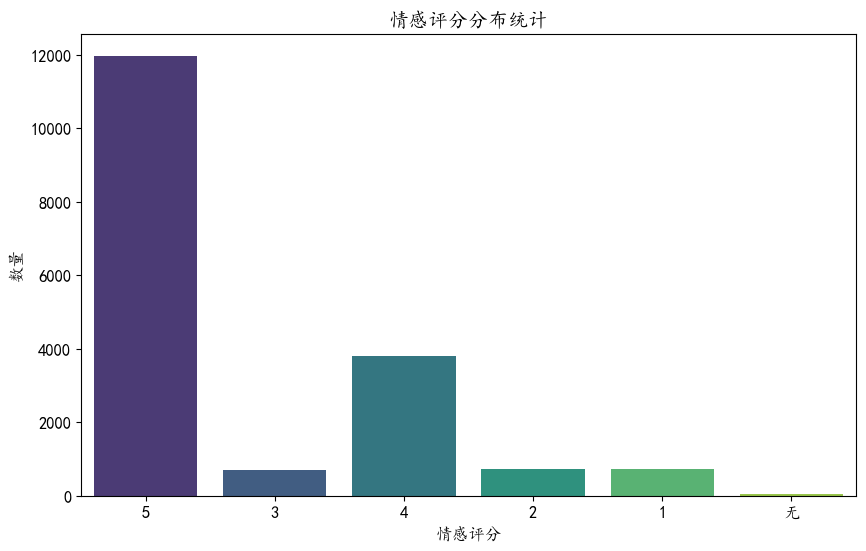

In [16]:
# 假设你的DataFrame名称为df，并且情感评分列为'情感评分'
plt.figure(figsize=(10, 6))
sns.countplot(data=df_extracted, x='情感评分', palette='viridis')

# 设置图表标题和标签
plt.title('情感评分分布统计')
plt.xlabel('情感评分')
plt.ylabel('数量')

# 显示图表
plt.show()

### 情感评分大致

In [17]:
# 定义提取信息的函数
def extract_keywords_and_score(text):
    quality_pattern = r"- 产品质量相关:\s*(.*?)\n"
    experience_pattern = r"- 使用体验相关:\s*(.*?)\n"
    packaging_pattern = r"- 包装相关:\s*(.*?)\n"
    price_pattern = r"- 价格相关:\s*(.*?)\n"
    sentiment_pattern = r"- 评分:\s*(\d)"

    quality_keywords = re.findall(quality_pattern, text, re.DOTALL)
    experience_keywords = re.findall(experience_pattern, text, re.DOTALL)
    packaging_keywords = re.findall(packaging_pattern, text, re.DOTALL)
    price_keywords = re.findall(price_pattern, text, re.DOTALL)
    sentiment_score = re.findall(sentiment_pattern, text, re.DOTALL)

    return {
        '产品质量关键词': quality_keywords[0] if quality_keywords else '无',
        '使用体验关键词': experience_keywords[0] if experience_keywords else '无',
        '包装关键词': packaging_keywords[0] if packaging_keywords else '无',
        '价格关键词': price_keywords[0] if price_keywords else '无',
        '情感评分': int(sentiment_score[0].replace("星", "")) if sentiment_score else 3
    }


df_keywords = final_df['输出结果'].apply(extract_keywords_and_score)
df_extracted = pd.concat([final_df, pd.DataFrame(df_keywords.tolist())], axis=1)

In [18]:
data_analysis(df_extracted)

,Column,Data Type,Unique values,NaN
0,Unnamed: 0,int64,17966,0.0
0,评价时间,object,1817,0.0
0,评价内容,object,17420,0.0
0,来源平台,object,2,0.0
0,页面标题,object,25,0.0
0,品牌名称,object,7,0.0
0,品牌大类,object,4,0.0
0,评论字数,int64,312,0.0
0,输出结果,object,17596,0.0
0,产品质量关键词,object,12181,0.0


C:\Users\Admin\AppData\Local\Temp\ipykernel_48888\3403881531.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=score_counts.index, y=score_counts.values, palette="Blues_d")
C:\Users\Admin\AppData\Roaming\Python\Python39\site-packages\pandas\core\algorithms.py:518: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
C:\Users\Admin\AppData\Roaming\Python\Python39\site-packages\pandas\core\algorithms.py:518: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more informatio

Text(0, 0.5, '数量')

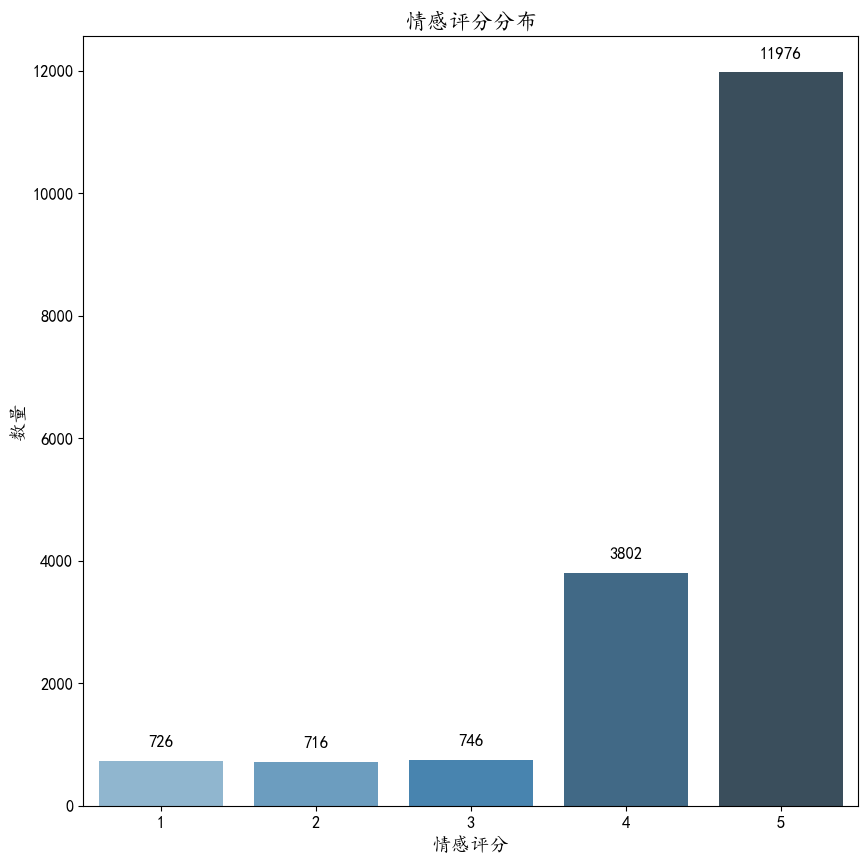

In [19]:
# 统计每个情感评分的数量
score_counts = df_extracted['情感评分'].value_counts().sort_index()

# 创建柱状图
plt.figure(figsize=(10, 10))
sns.barplot(x=score_counts.index, y=score_counts.values, palette="Blues_d")

# 显示每个柱子的具体数值
for index, value in enumerate(score_counts.values):
    plt.text(index, value + 200, str(value), ha='center', va='bottom', fontsize=12)

# 添加标题和标签
plt.title('情感评分分布', fontsize=16)
plt.xlabel('情感评分', fontsize=14)
plt.ylabel('数量', fontsize=14)

# 分析数据

## 时间分布

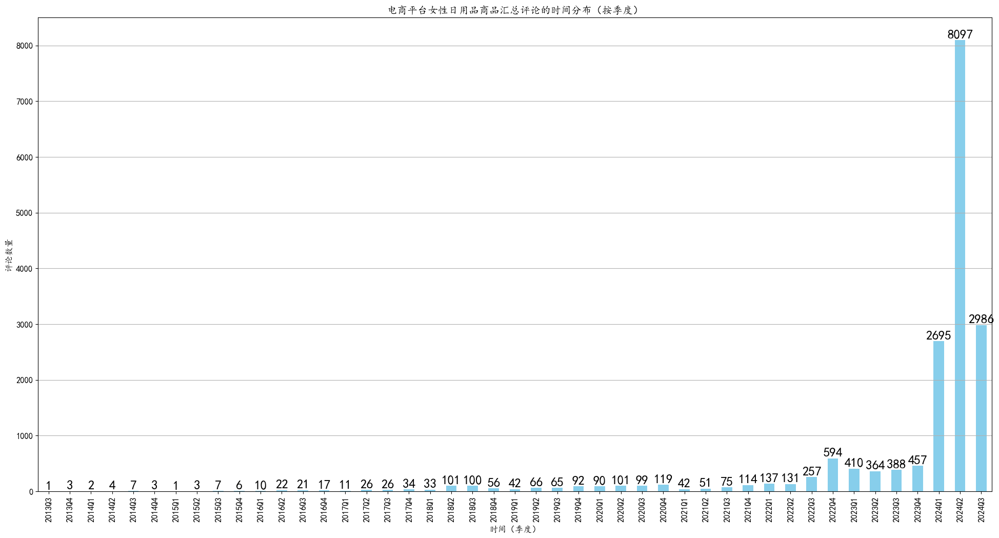

In [20]:
# 按月度统计评论数量
df = df_extracted.copy()
# 先将 '评价时间' 列转换为 datetime 类型
df['time'] = pd.to_datetime(df['评价时间'], errors='coerce')

# 转换成功后再执行后续操作，按季度统计
quarterly_counts = df['time'].dt.to_period('Q').value_counts().sort_index()

# 绘制评论的时间分布柱状图
plt.figure(figsize=(24, 12))
quarterly_counts.plot(kind='bar', color='skyblue')

# 设置图表标题和标签
plt.title('电商平台女性日用品商品汇总评论的时间分布（按季度）')
plt.xlabel('时间（季度）')
plt.ylabel('评论数量')

# 显示具体的数字
for index, value in enumerate(quarterly_counts):
    plt.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=18)

plt.grid(True, axis='y')  # 仅显示Y轴的网格线
plt.show()

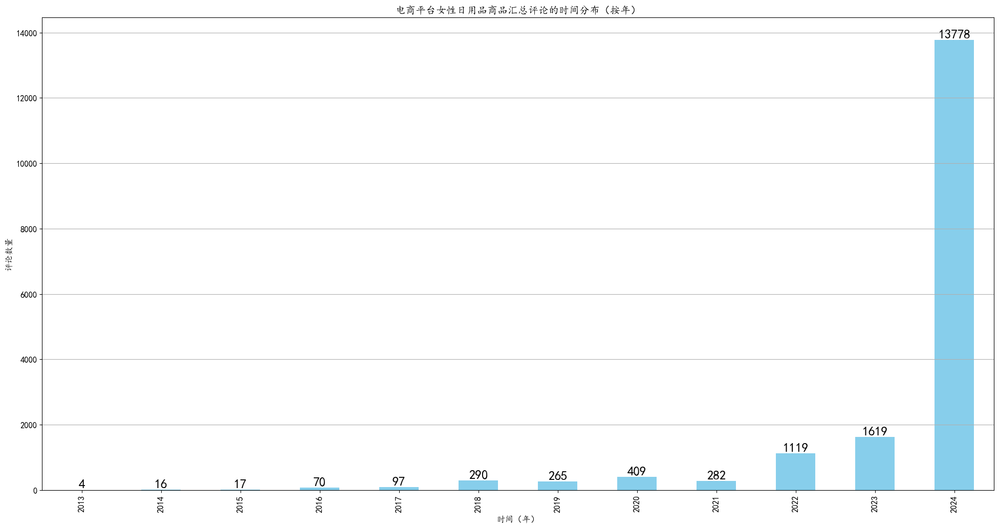

In [21]:
# 按月度统计评论数量
df = df_extracted.copy()
# 先将 '评价时间' 列转换为 datetime 类型
df['time'] = pd.to_datetime(df['评价时间'], errors='coerce')

# 转换成功后再执行后续操作，按季度统计
quarterly_counts = df['time'].dt.to_period('Y').value_counts().sort_index()

# 绘制评论的时间分布柱状图
plt.figure(figsize=(24, 12))
quarterly_counts.plot(kind='bar', color='skyblue')

# 设置图表标题和标签
plt.title('电商平台女性日用品商品汇总评论的时间分布（按年）')
plt.xlabel('时间（年）')
plt.ylabel('评论数量')

# 显示具体的数字
for index, value in enumerate(quarterly_counts):
    plt.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=18)

plt.grid(True, axis='y')  # 仅显示Y轴的网格线
plt.show()

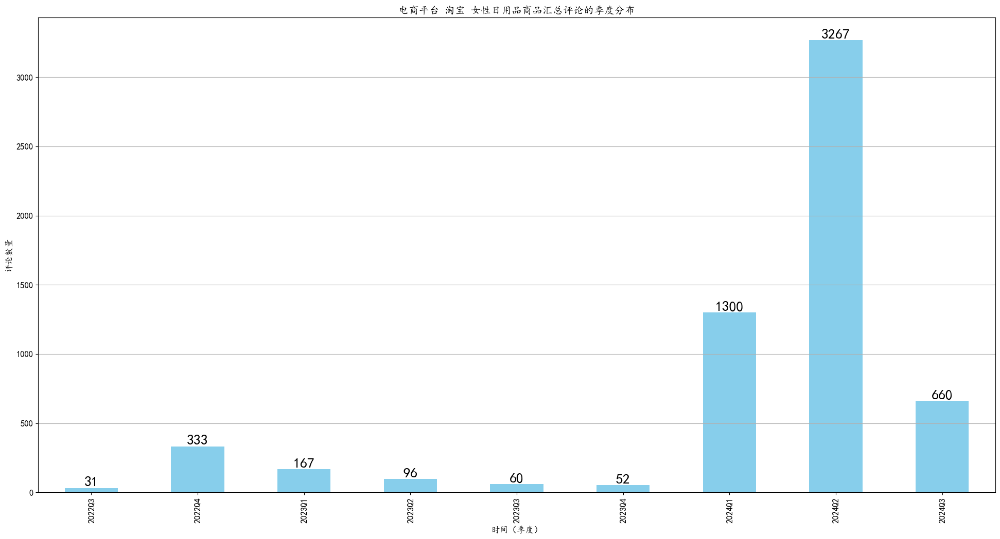

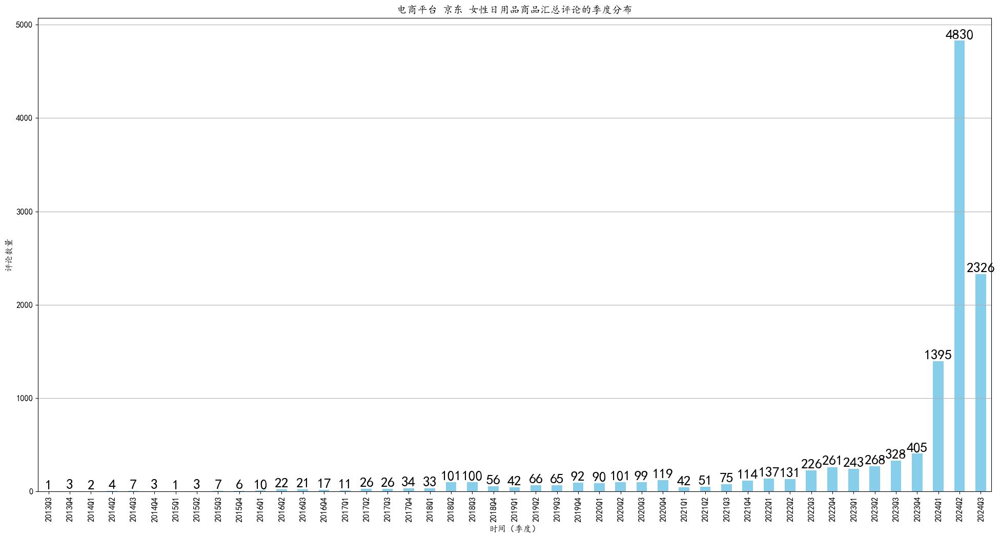

In [22]:
# 按平台分组
platforms = df['来源平台'].unique()

# 为每个平台绘制一个柱状图
for platform in platforms:
    platform_df = df[df['来源平台'] == platform]
    quarterly_counts = platform_df['time'].dt.to_period('Q').value_counts().sort_index()

    # 绘制评论的时间分布柱状图
    plt.figure(figsize=(24, 12))
    quarterly_counts.plot(kind='bar', color='skyblue')

    # 设置图表标题和标签
    plt.title(f'电商平台 {platform} 女性日用品商品汇总评论的季度分布')
    plt.xlabel('时间（季度）')
    plt.ylabel('评论数量')

    # 显示具体的数字
    for index, value in enumerate(quarterly_counts):
        plt.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=20)

    plt.grid(True, axis='y')  # 仅显示Y轴的网格线
    plt.show()

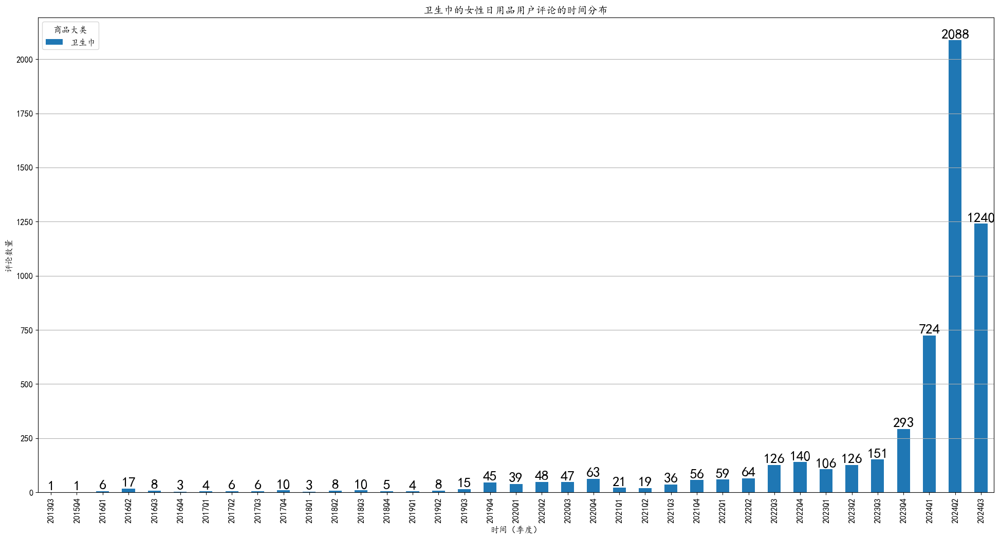

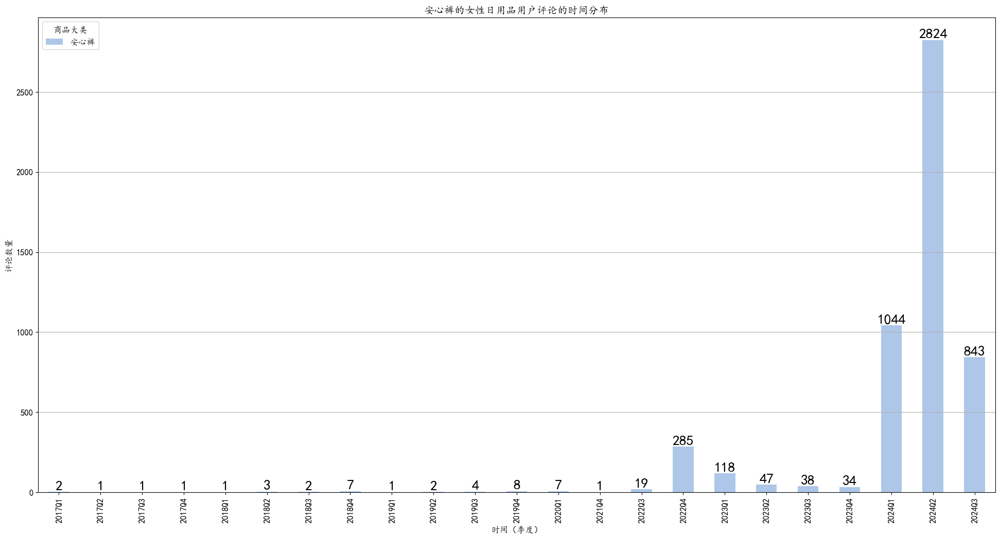

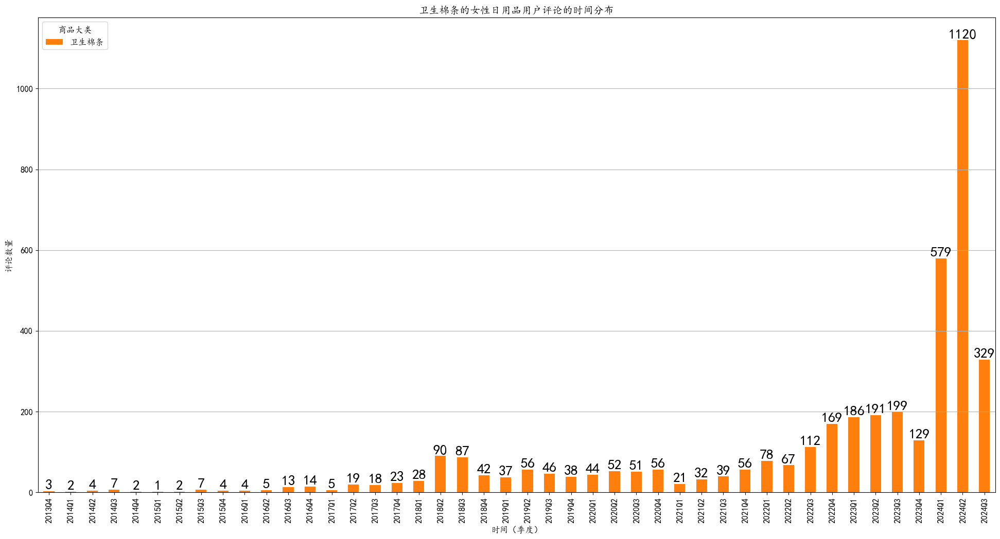

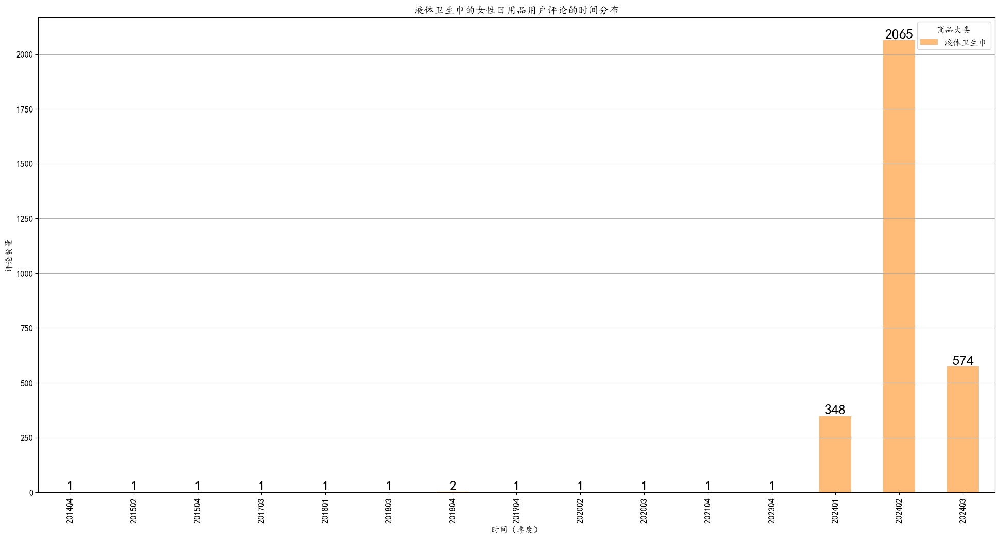

In [23]:
# 获取所有商品大类
categories = df['品牌大类'].unique()

# 为每个商品大类绘制单独的图
for category in categories:
    plt.figure(figsize=(24, 12))

    # 按商品大类和季度统计评论数量
    quarterly_counts_by_category = df[df['品牌大类'] == category]['time'].dt.to_period('Q').value_counts().sort_index()

    # 绘制柱状图，颜色根据商品大类设置不同颜色
    quarterly_counts_by_category.plot(kind='bar', color=plt.cm.get_cmap('tab20')(categories.tolist().index(category)), label=category)

    # 设置图表标题和标签
    plt.title(f'{category}的女性日用品用户评论的时间分布')
    plt.xlabel('时间（季度）')
    plt.ylabel('评论数量')

    # 显示图例
    plt.legend(title='商品大类')
    # 显示具体的数字
    for index, value in enumerate(quarterly_counts_by_category):
        plt.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=20)

    # 显示网格
    plt.grid(True, axis='y')

    # 显示图表
    plt.show()

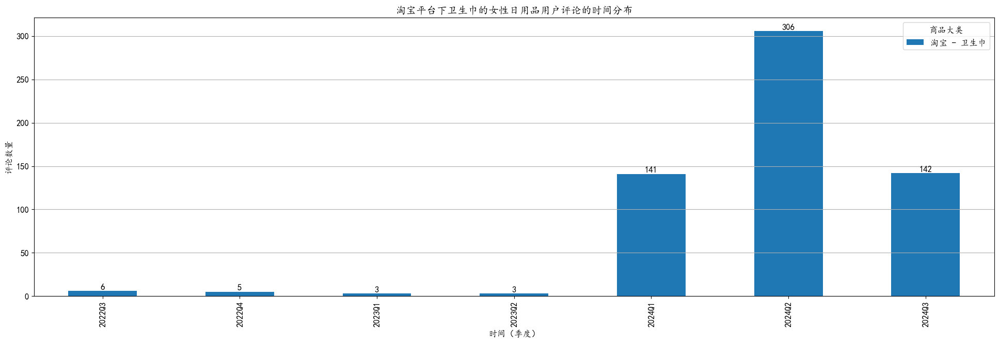

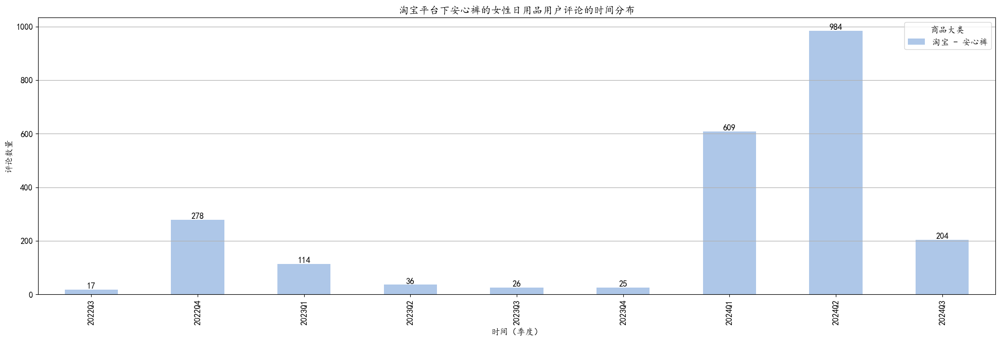

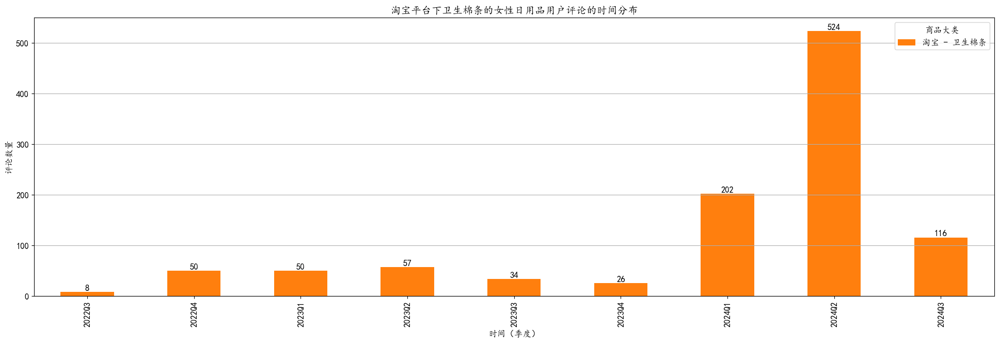

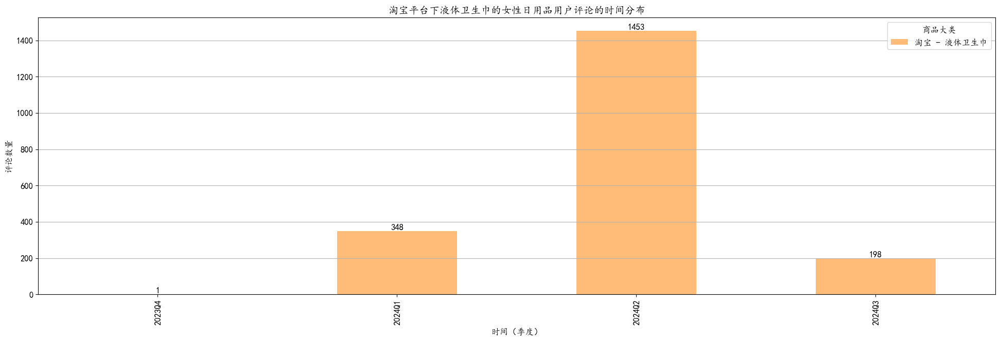

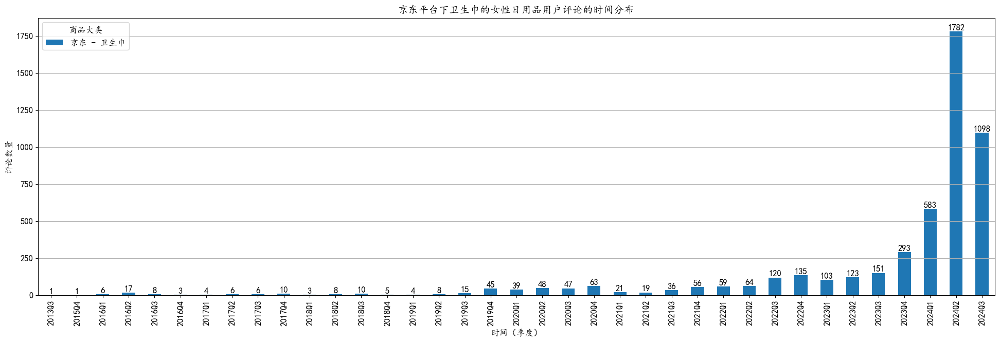

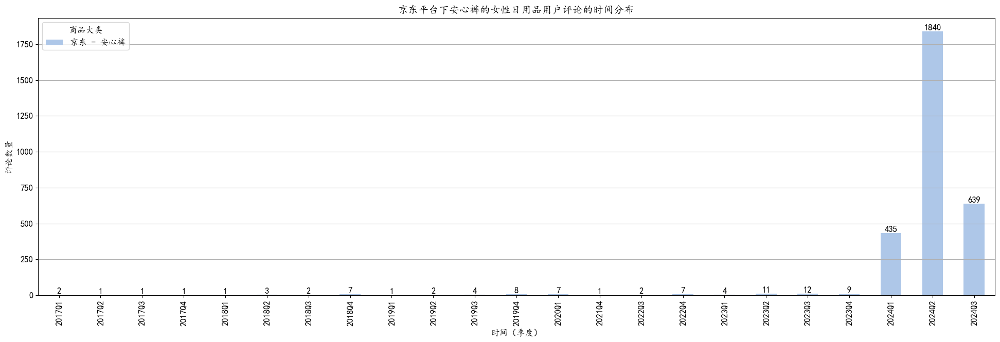

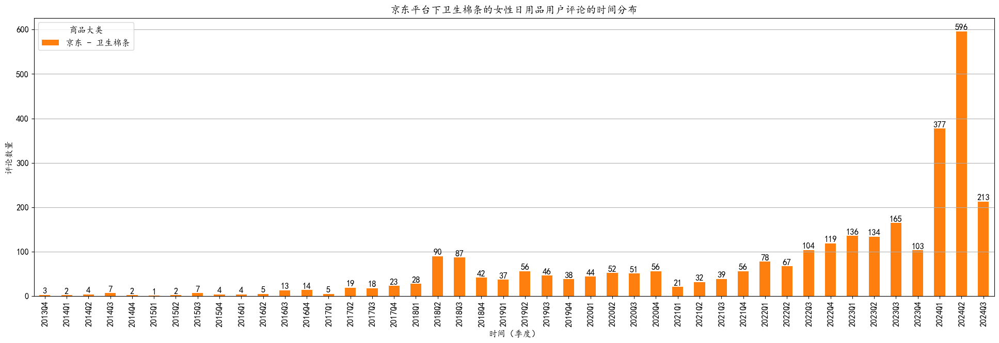

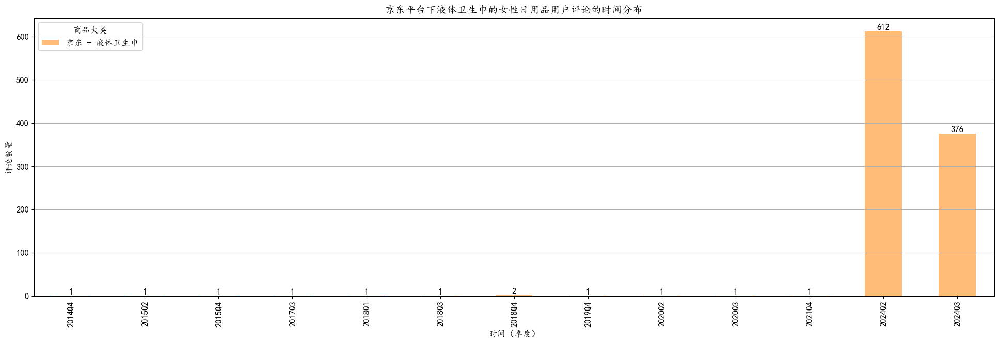

In [24]:
# 获取所有平台
platforms = df['来源平台'].unique()

# 获取所有商品大类
categories = df['品牌大类'].unique()

# 为每个平台和商品大类绘制单独的图
for platform in platforms:
    for category in categories:
        plt.figure(figsize=(24, 7))

        # 按平台和商品大类按季度统计评论数量
        quarterly_counts_by_category = df[(df['来源平台'] == platform) & (df['品牌大类'] == category)]['time'].dt.to_period('Q').value_counts().sort_index()

        # 绘制柱状图，颜色根据商品大类设置不同颜色
        ax = quarterly_counts_by_category.plot(kind='bar', color=plt.cm.get_cmap('tab20')(categories.tolist().index(category)), label=f'{platform} - {category}')

        # 设置图表标题和标签
        plt.title(f'{platform}平台下{category}的女性日用品用户评论的时间分布')
        plt.xlabel('时间（季度）')
        plt.ylabel('评论数量')

        # 在每个柱子上显示具体的数字
        for index, value in enumerate(quarterly_counts_by_category):
            ax.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=12)

        # 显示图例
        plt.legend(title='商品大类')

        # 显示网格
        plt.grid(True, axis='y')

        # 显示图表
        plt.show()


# 评论字数情况

In [25]:
df.columns

Index(['Unnamed: 0', '评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数',
       '输出结果', '产品质量关键词', '使用体验关键词', '包装关键词', '价格关键词', '情感评分', 'time'],
      dtype='object')

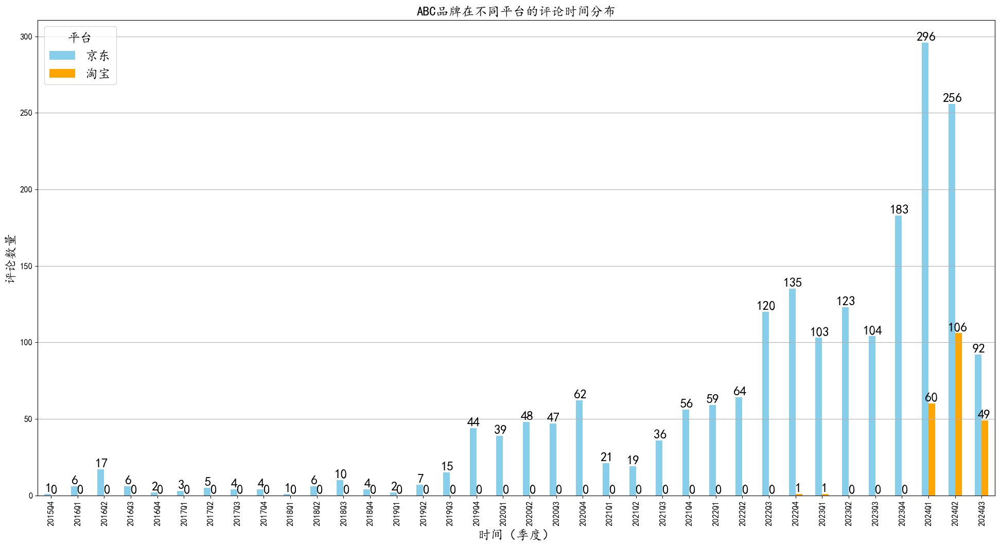

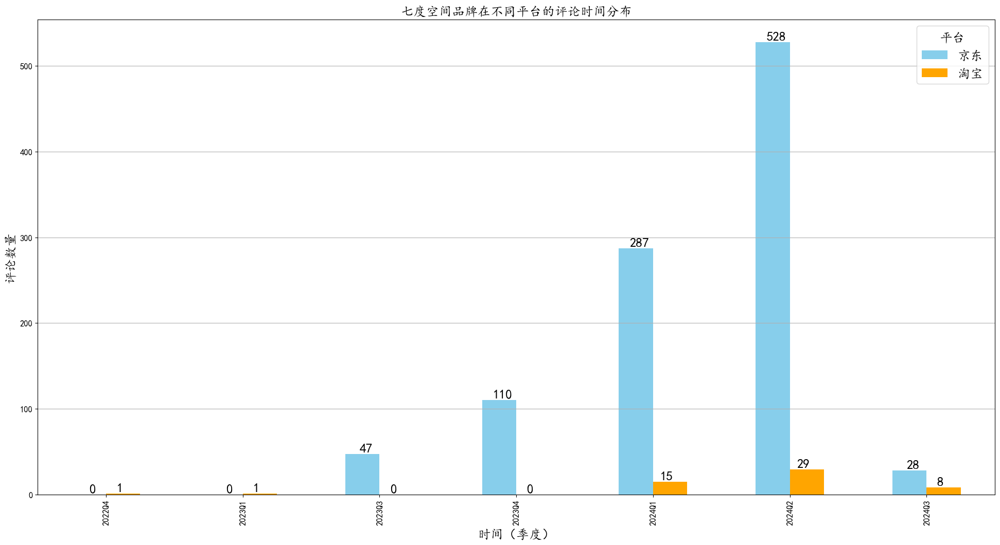

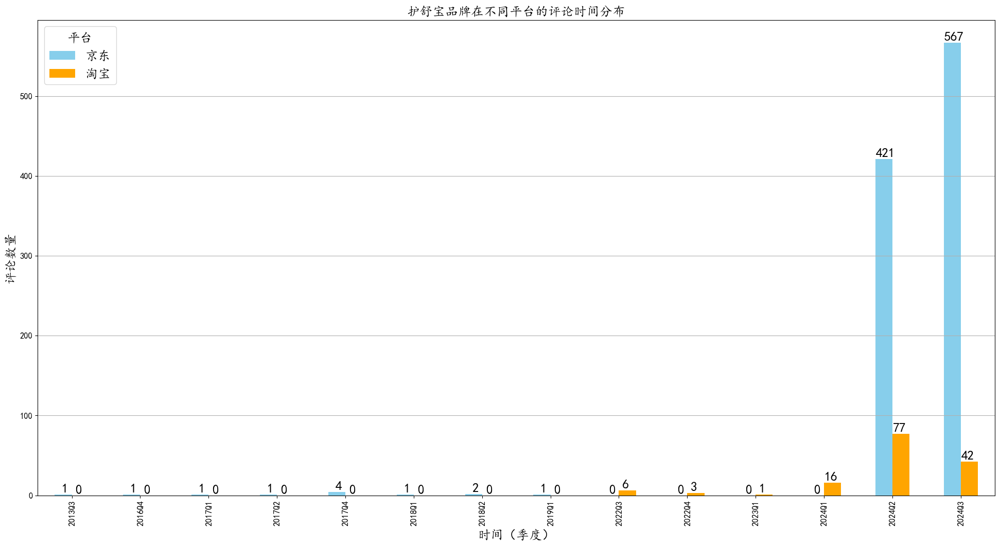

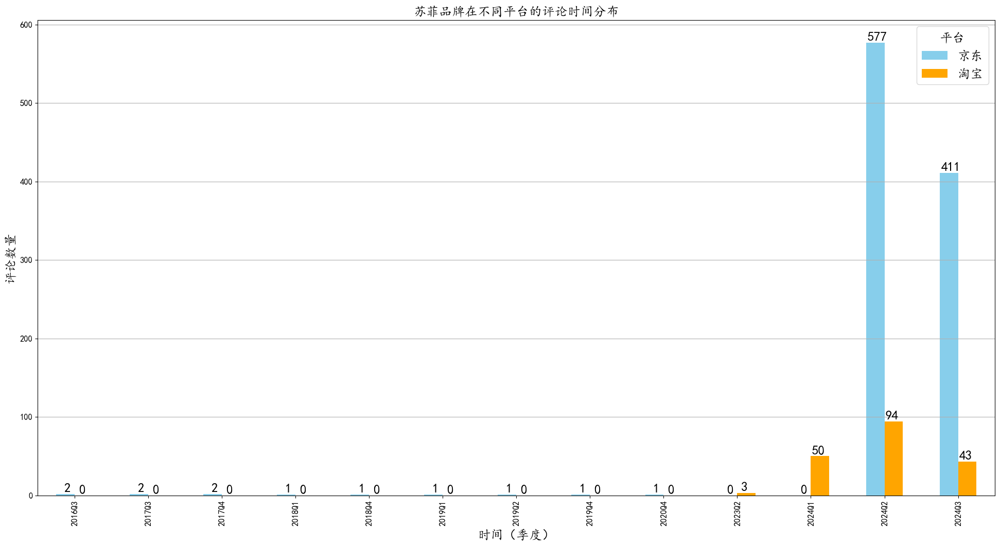

In [26]:
# 筛选出卫生巾类别的数据
df_weishengjin = df[df['品牌大类'] == '卫生巾']

# 获取所有品牌
brands = df_weishengjin['品牌名称'].unique()

# 获取所有平台
platforms = ['京东', '淘宝']  # 可以根据你的数据调整平台名称

# 为每个品牌绘制单独的图
for brand in brands:
    plt.figure(figsize=(24, 12))

    # 初始化一个字典来存储平台的评论数量
    platform_counts = {}

    # 按平台统计该品牌的季度评论数量
    for platform in platforms:
        quarterly_counts_by_platform = df_weishengjin[(df_weishengjin['来源平台'] == platform) & (df_weishengjin['品牌名称'] == brand)]['time'].dt.to_period('Q').value_counts().sort_index()
        platform_counts[platform] = quarterly_counts_by_platform

    # 将平台数据转换为DataFrame，方便绘图
    df_platform_counts = pd.DataFrame(platform_counts).fillna(0)

    # 绘制柱状图
    df_platform_counts.plot(kind='bar', color=['skyblue', 'orange'], ax=plt.gca())

    # 设置图表标题和标签
    plt.title(f'{brand}品牌在不同平台的评论时间分布', fontsize=18)
    plt.xlabel('时间（季度）', fontsize=18)
    plt.ylabel('评论数量', fontsize=18)

    # 显示图例
    plt.legend(title='平台', fontsize=18, title_fontsize=18)

    # 显示具体的数字
    for i in range(len(df_platform_counts)):
        for j, platform in enumerate(platforms):
            plt.text(i - 0.1 + 0.2 * j, df_platform_counts.iloc[i, j], str(int(df_platform_counts.iloc[i, j])),
                 ha='center', va='bottom', fontsize=18, fontweight='bold')

    # 显示网格
    plt.grid(True, axis='y')

    # 显示图表
    plt.show()

In [27]:
df.columns

Index(['Unnamed: 0', '评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数',
       '输出结果', '产品质量关键词', '使用体验关键词', '包装关键词', '价格关键词', '情感评分', 'time'],
      dtype='object')

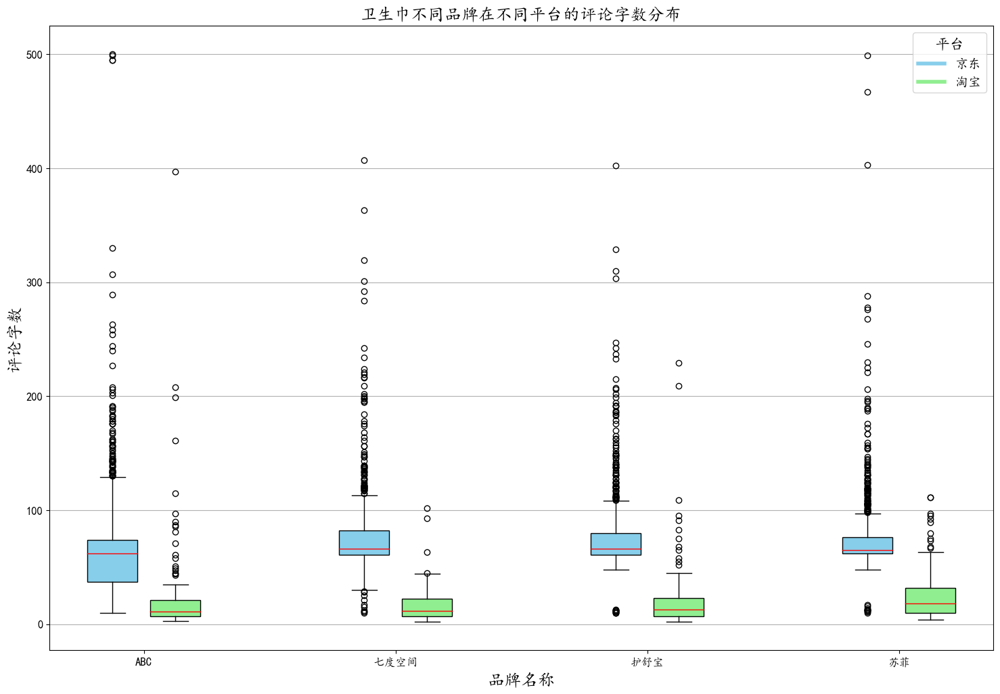

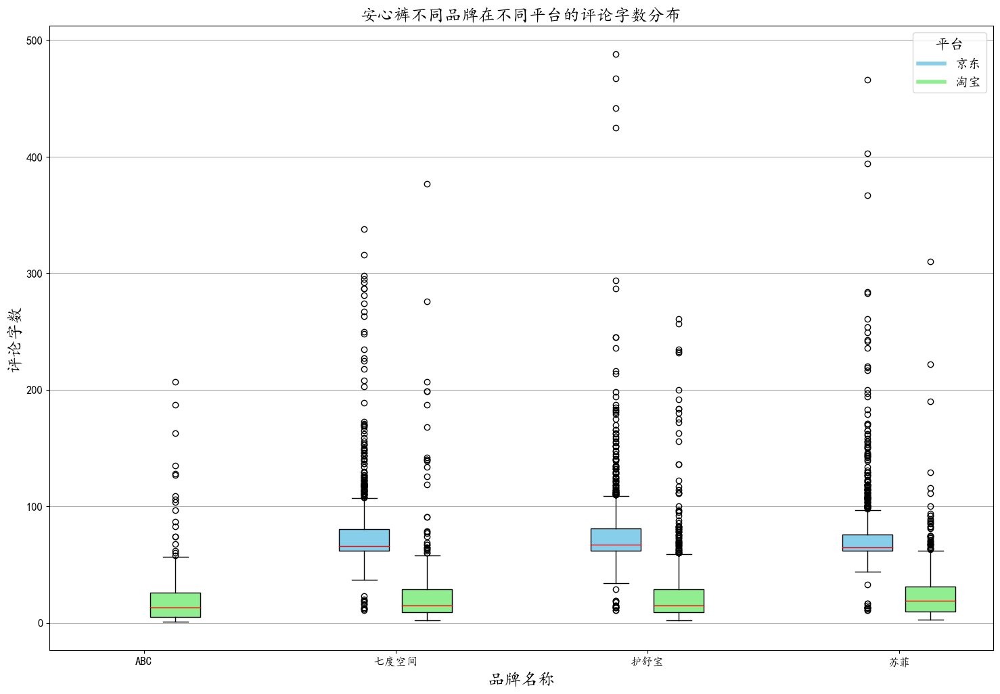

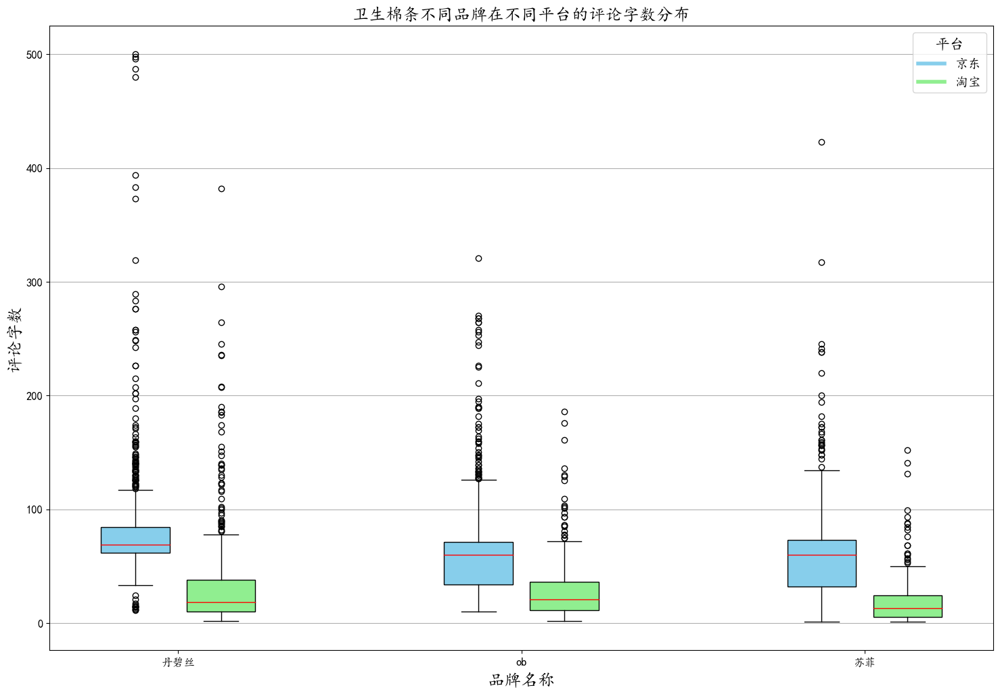

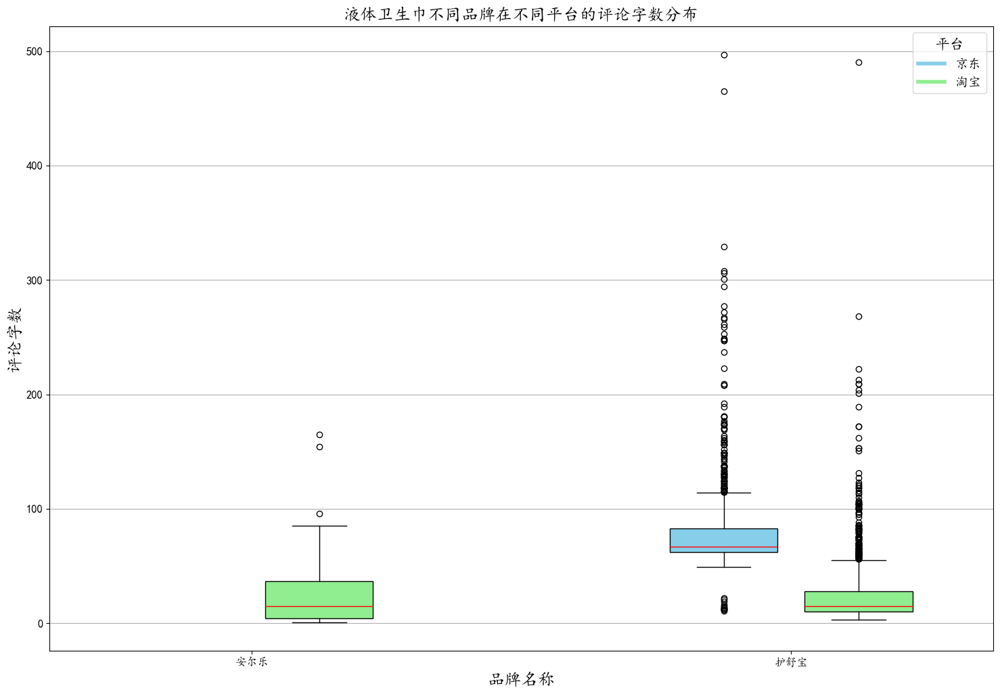

In [28]:
colors = {'京东': 'skyblue', '淘宝': 'lightgreen'}
# 筛选出卫生巾类别的数据
category_list = list(set(df['品牌大类']))

for category_name in category_list:
	df_weishengjin = df[df['品牌大类'] == category_name]

	# 获取所有品牌
	brands = df_weishengjin['品牌名称'].unique()

	# 获取所有平台
	platforms = ['京东', '淘宝']  # 根据数据的实际平台名调整

	# 初始化数据结构以存储每个品牌的评论字数数据
	brand_platform_data = {}

	for brand in brands:
	    brand_platform_data[brand] = []
	    for platform in platforms:
	        # 获取该品牌在该平台上的评论字数，并按季度汇总
	        word_counts_by_platform = df_weishengjin[(df_weishengjin['来源平台'] == platform) &
	                                                 (df_weishengjin['品牌名称'] == brand)]['评论字数']
	        brand_platform_data[brand].append(word_counts_by_platform)

	# 绘制箱线图
	plt.figure(figsize=(18, 12))

	# 用于控制不同品牌的位置
	positions = []

	for brand_index, brand in enumerate(brands):
	    # 确定箱线图的横坐标位置
	    positions.extend([brand_index * 2 + i * 0.5 for i in range(len(platforms))])

	    # 绘制不同平台的箱线图
	    for i, platform in enumerate(platforms):
	        plt.boxplot(brand_platform_data[brand][i], positions=[brand_index * 2 + i * 0.5], widths=0.4,
	                    patch_artist=True, boxprops=dict(facecolor=colors[platforms[i]]), medianprops=dict(color='red'))

	# 设置图表标题和标签
	plt.title(f'{category_name}不同品牌在不同平台的评论字数分布', fontsize=18)
	plt.xlabel('品牌名称', fontsize=18)
	plt.ylabel('评论字数', fontsize=18)
	plt.xticks([i * 2 + 0.25 for i in range(len(brands))], brands)  # 使品牌名与箱线图居中对齐

	# 添加图例
	handles = [plt.Line2D([0], [0], color=colors[platform], lw=4) for platform in platforms]
	plt.legend(handles, platforms, title="平台", fontsize=14, title_fontsize=16)

	# 显示网格
	plt.grid(True, axis='y')

	# 显示图表
	plt.show()

# 评分情况

In [29]:
brand = list(set(df['品牌名称']))
brand

['安尔乐', 'ABC', '苏菲', '护舒宝', 'ob', '丹碧丝', '七度空间']

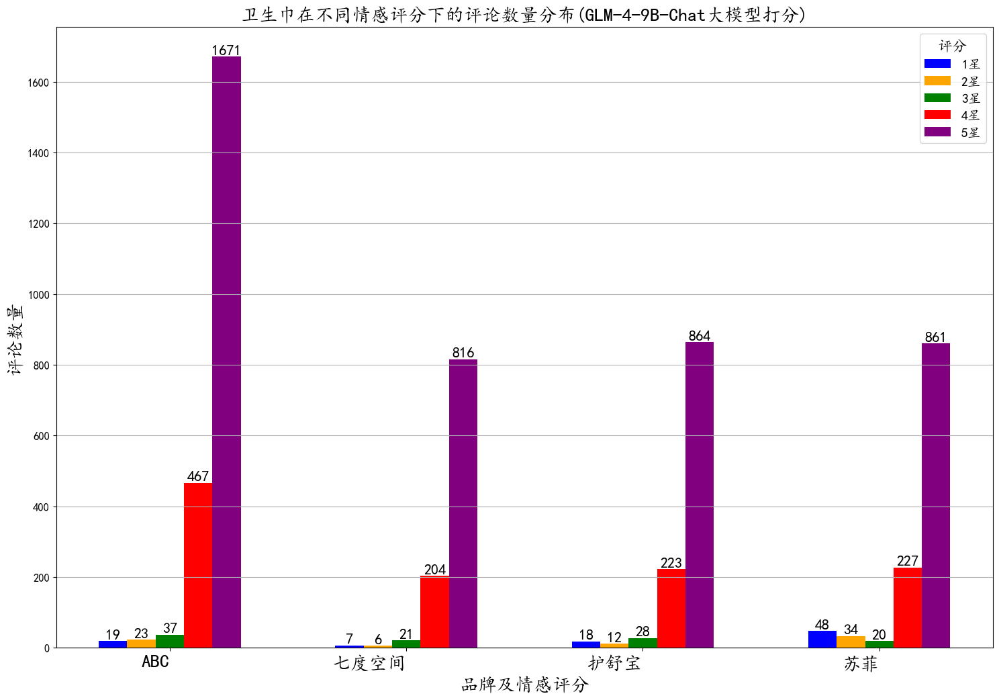

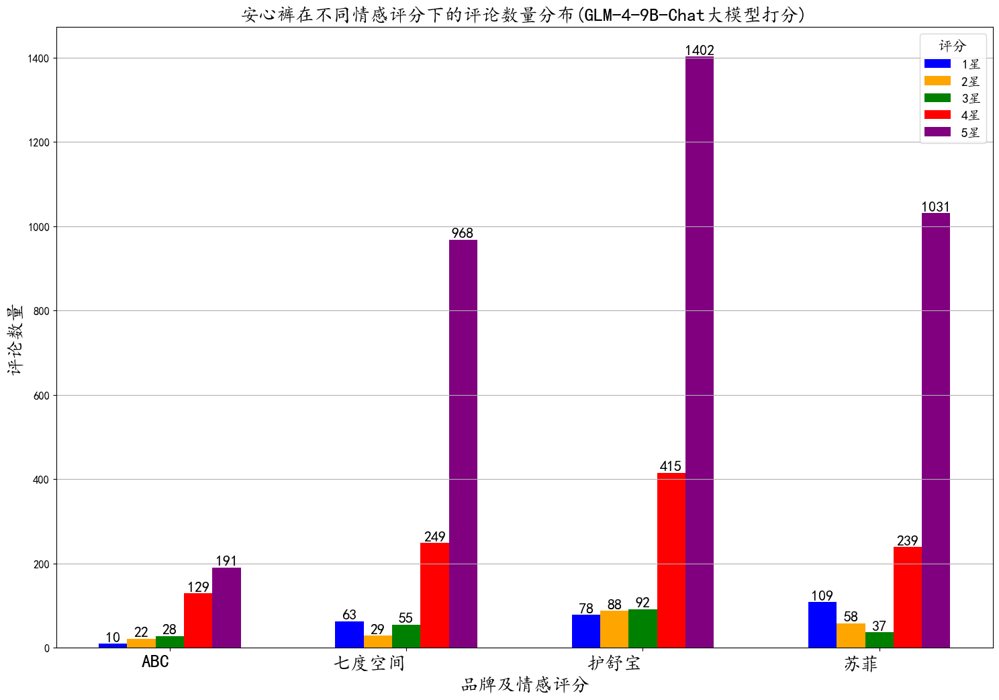

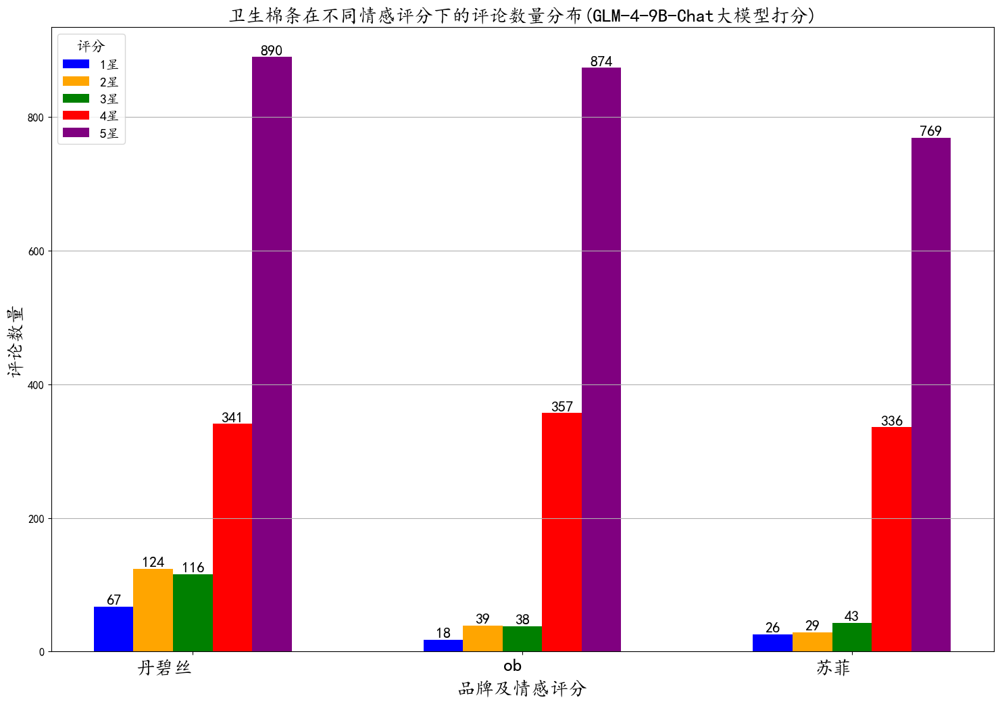

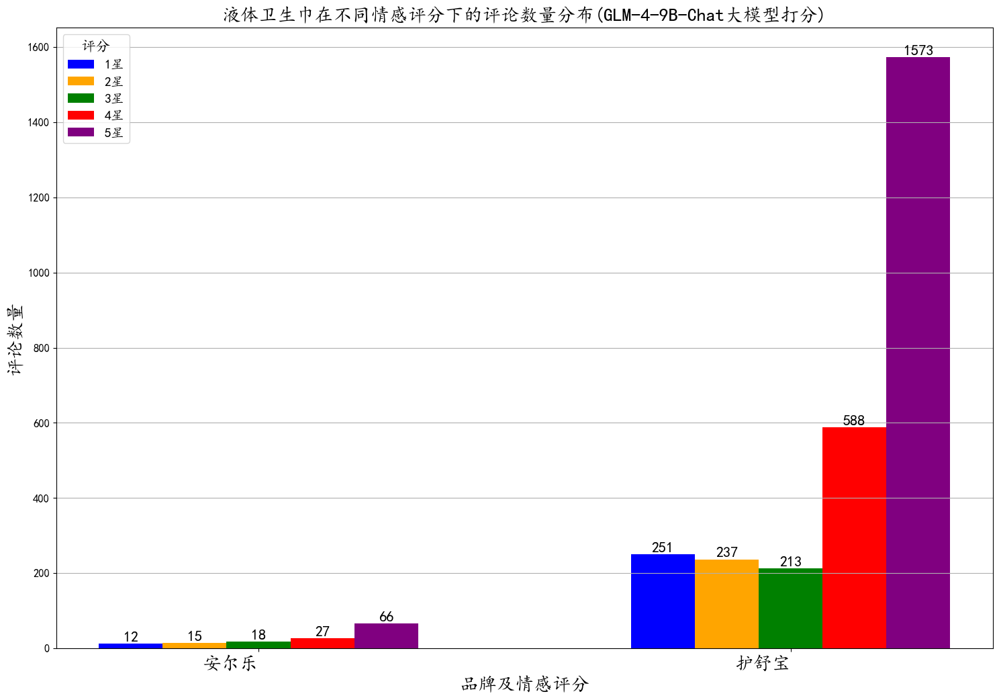

In [30]:
# 假设 df_weishengjin 已经包含所有数据
# 筛选出卫生巾类别的数据
# 获取所有品牌
# 筛选出卫生巾类别的数据
category_list = list(set(df['品牌大类']))

for category_name in category_list:
	df_weishengjin = df[df['品牌大类'] == category_name]
	brands = df_weishengjin['品牌名称'].unique()

	# 定义情感评分的范围
	ratings = [1, 2, 3, 4, 5]

	# 定义颜色映射
	colors = {1: 'blue', 2: 'orange', 3: 'green', 4: 'red', 5: 'purple'}

	# 为每个品牌绘制柱状图
	plt.figure(figsize=(18, 12))

	bar_width = 0.15  # 每个柱子的宽度
	space_between_brands = 0.5  # 品牌之间的间隔

	for brand_index, brand in enumerate(brands):
	    # 初始化存储每个评分的评论数量
	    rating_counts = []

	    for rating in ratings:
	        # 计算每个评分的评论数量
	        count = df_weishengjin[(df_weishengjin['品牌名称'] == brand) & (df_weishengjin['情感评分'] == rating)].shape[0]
	        rating_counts.append(count)

	    # 计算每个柱子的X轴位置
	    positions = np.arange(len(ratings)) * bar_width + brand_index * (bar_width * len(ratings) + space_between_brands)

	    # 绘制每个情感评分的柱子
	    for i, rating in enumerate(ratings):
	        plt.bar(positions[i], rating_counts[i], color=colors[rating], width=bar_width, label=f'{rating}星' if brand_index == 0 else "")
			 # 在每个柱子上显示具体的数值
	        plt.text(positions[i], rating_counts[i] + 0.5, str(rating_counts[i]), ha='center', va='bottom', fontsize=16)

	# 设置图表标题和标签
	plt.title(f'{category_name}在不同情感评分下的评论数量分布(GLM-4-9B-Chat大模型打分)', fontsize=20)
	plt.xlabel('品牌及情感评分', fontsize=20)
	plt.ylabel('评论数量', fontsize=20)

	# 设置x轴的刻度标签，使品牌名与柱状图居中对齐
	brand_labels = []
	for brand in brands:
	    for rating in ratings:
	        brand_labels.append(f'{rating}星')

	# 生成x轴标签
	tick_positions = [i * (bar_width * len(ratings) + space_between_brands) + (bar_width * len(ratings) - bar_width) / 2 for i in range(len(brands))]
	plt.xticks(tick_positions, brands, rotation=0, ha='right', fontsize=20)

	# 添加图例
	plt.legend(title="评分", fontsize=14, title_fontsize=16)

	# 显示网格
	plt.grid(True, axis='y')

	# 显示图表
	plt.show()

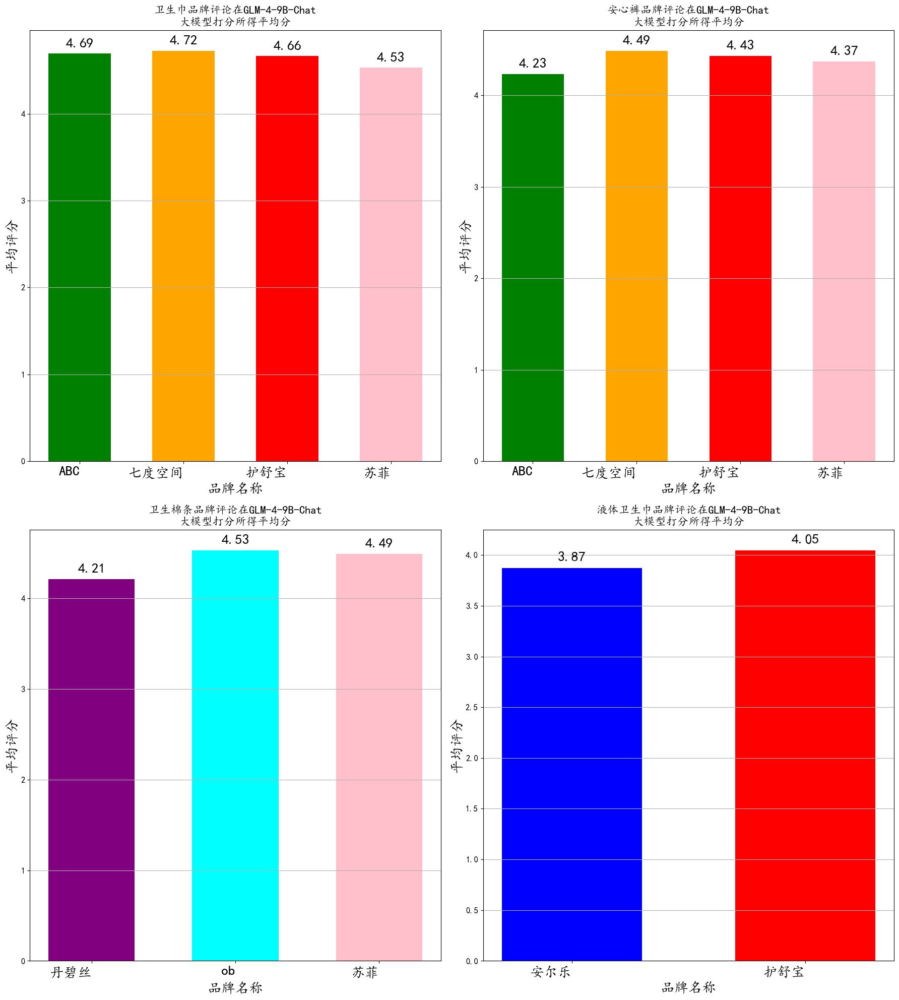

In [51]:
# 假设 df_weishengjin 已经包含所有数据
category_list = list(set(df['品牌大类']))

# 定义颜色映射
brand_colors = {
    '安尔乐': 'blue',
    '七度空间': 'orange',
    'ABC': 'green',
    '护舒宝': 'red',
    '丹碧丝': 'purple',
    '苏菲': 'pink',
    'ob': 'cyan'
}

# 创建一个包含四个子图的图表
fig, axes = plt.subplots(2, 2, figsize=(18, 20))  # 2x2网格布局

# 平铺模式下的索引
axes = axes.flatten()

for idx, category_name in enumerate(category_list):
    df_weishengjin = df[df['品牌大类'] == category_name]
    brands = df_weishengjin['品牌名称'].unique()

    # 为每个品牌计算情感评分的平均值
    average_ratings = []
    for brand in brands:
        avg_rating = df_weishengjin[df_weishengjin['品牌名称'] == brand]['情感评分'].mean()
        average_ratings.append(avg_rating)

    # 计算每个柱子的X轴位置
    positions = np.arange(len(brands))

    # 获取品牌对应的颜色
    colors = [brand_colors.get(brand, 'gray') for brand in brands]

    # 在子图上绘制柱状图
    axes[idx].bar(positions, average_ratings, color=colors, width=0.6)

    # 在每个柱子上显示具体的平均分数值
    for i, avg_rating in enumerate(average_ratings):
        axes[idx].text(positions[i], avg_rating + 0.05, f'{avg_rating:.2f}', ha='center', va='bottom', fontsize=20)

    # 设置子图的标题和标签
    axes[idx].set_title(f'{category_name}品牌评论在GLM-4-9B-Chat\n大模型打分所得平均分', fontsize=16)
    axes[idx].set_xlabel('品牌名称', fontsize=20)
    axes[idx].set_ylabel('平均评分', fontsize=20)

    # 设置X轴刻度标签为品牌名称
    axes[idx].set_xticks(positions)
    axes[idx].set_xticklabels(brands, rotation=0, ha='right', fontsize=20)

    # 显示网格
    axes[idx].grid(True, axis='y')

# 调整子图之间的间距
plt.tight_layout()

# 显示合并后的图表
plt.show()


# 关键词情况

In [35]:
df.columns

Index(['Unnamed: 0', '评价时间', '评价内容', '来源平台', '页面标题', '品牌名称', '品牌大类', '评论字数',
       '输出结果', '产品质量关键词', '使用体验关键词', '包装关键词', '价格关键词', '情感评分', 'time',
       '关键词列表'],
      dtype='object')

In [36]:
import re
from LAC import LAC
from wordcloud import WordCloud

In [ ]:
# 假设 df_weishengjin 是你提供的 DataFrame
lac = LAC(mode='seg', use_cuda=True)

# 定义一个函数来切分句子
def split_sentences(text):
    # 通过标点符号进行切分
    sentences = re.split(r'[，。！？、,.!?]', text)
    return [s.strip() for s in sentences if s.strip()]

# 定义一个函数使用LAC模型对句子进行分词
def lac_cut_sentences(sentences):
    words = []
    for sentence in sentences:
        words.extend(lac.run(sentence))
    return words

# 对 DataFrame 进行关键词切分和分词处理
df['关键词列表'] = df['产品质量关键词'].apply(lambda x: lac_cut_sentences(split_sentences(x)))
df['关键词列表'] = df['关键词列表'] + df['使用体验关键词'].apply(lambda x: lac_cut_sentences(split_sentences(x)))
df['关键词列表'] = df['关键词列表'] + df['包装关键词'].apply(lambda x: lac_cut_sentences(split_sentences(x)))
df['关键词列表'] = df['关键词列表'] + df['价格关键词'].apply(lambda x: lac_cut_sentences(split_sentences(x)))

In [40]:
# 初始化LAC分词器
from nltk.corpus import stopwords
chinese_stopwords = stopwords.words('chinese')
stopwords_path = './stopwords.txt'
# 读取文件并将词汇添加到停用词列表中
with open(stopwords_path, 'r', encoding='utf-8') as file:
    words_from_file = file.read().split()

# 添加文件中的词汇到停用词列表中
chinese_stopwords.extend(words_from_file)

# 去重停用词列表中的词汇
stopwords = list(set(chinese_stopwords)) + ['无无', '无']

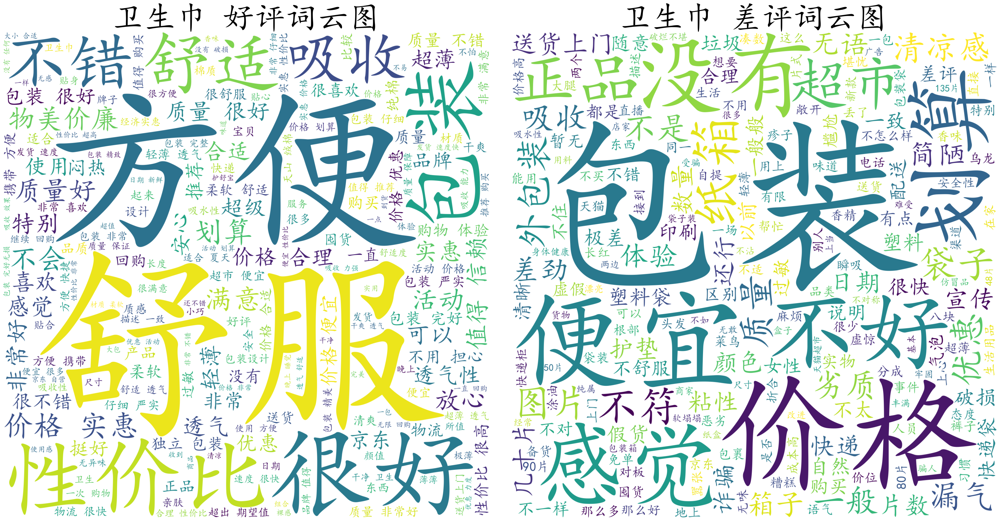

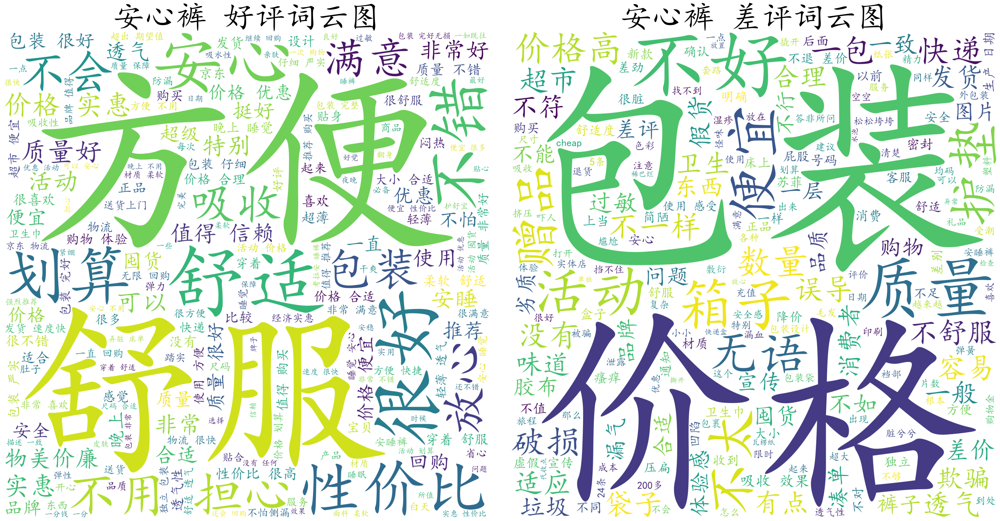

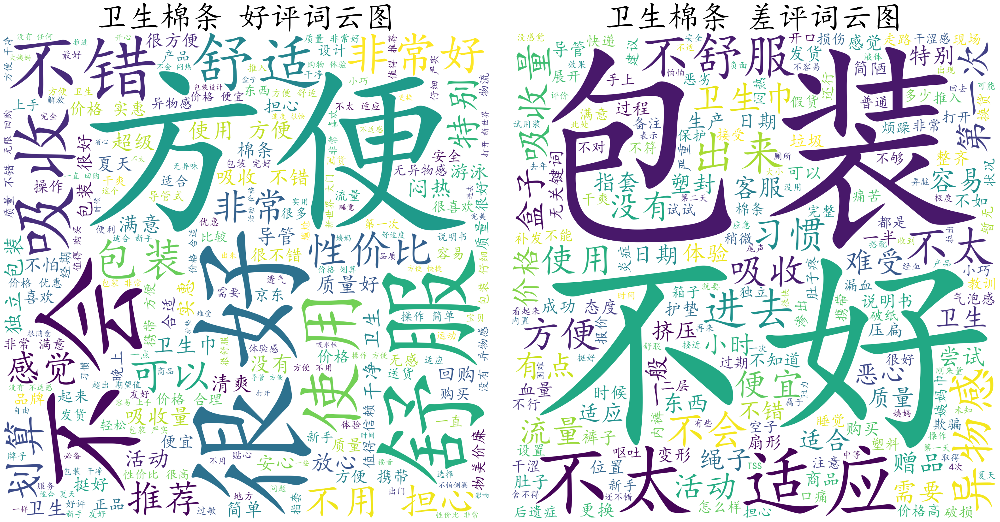

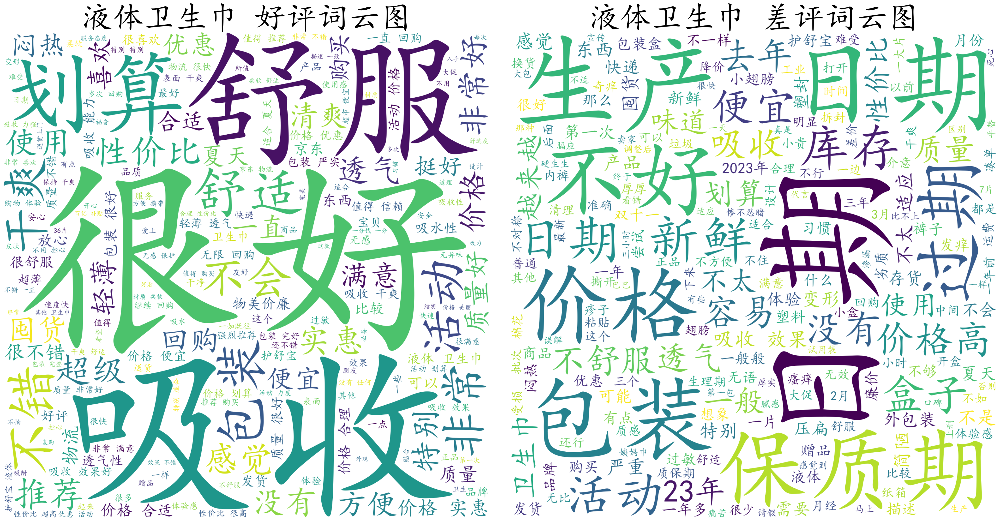

In [44]:
# 按品牌大类划分数据，并绘制词云
category_list = df['品牌大类'].unique()

# 设定字体路径
font_path = 'C:/Windows/Fonts/simkai.ttf'  # 请将路径替换为你本地的字体路径

for category in category_list:
    # 筛选出该类别的数据
    df_category = df[df['品牌大类'] == category]

    # 高星评论
    high_rating_words = df_category[df_category['情感评分'] >= 4]['关键词列表'].sum()
    high_rating_words = [word for word in high_rating_words if len(word) >= 2]
    # 差评评论
    low_rating_words = df_category[df_category['情感评分'] <= 2]['关键词列表'].sum()
    low_rating_words = [word for word in low_rating_words if len(word) >= 2]

    # 生成高星评论的词云图
    high_rating_wordcloud = WordCloud(font_path=font_path, width=1800, height=1800, background_color='white').generate(' '.join(high_rating_words))

    # 生成中差评评论的词云图
    low_rating_wordcloud = WordCloud(font_path=font_path, width=1800, height=1800, background_color='white').generate(' '.join(low_rating_words))

    # 绘制词云图
    plt.figure(figsize=(36, 18))

    # 高星词云
    plt.subplot(1, 2, 1)
    plt.imshow(high_rating_wordcloud, interpolation='bilinear')
    plt.title(f'{category} 好评词云图', fontsize=80)
    plt.axis('off')

    # 中差评词云
    plt.subplot(1, 2, 2)
    plt.imshow(low_rating_wordcloud, interpolation='bilinear')
    plt.title(f'{category} 差评词云图', fontsize=80)
    plt.axis('off')

    # 显示图像
    plt.tight_layout()
    plt.show()

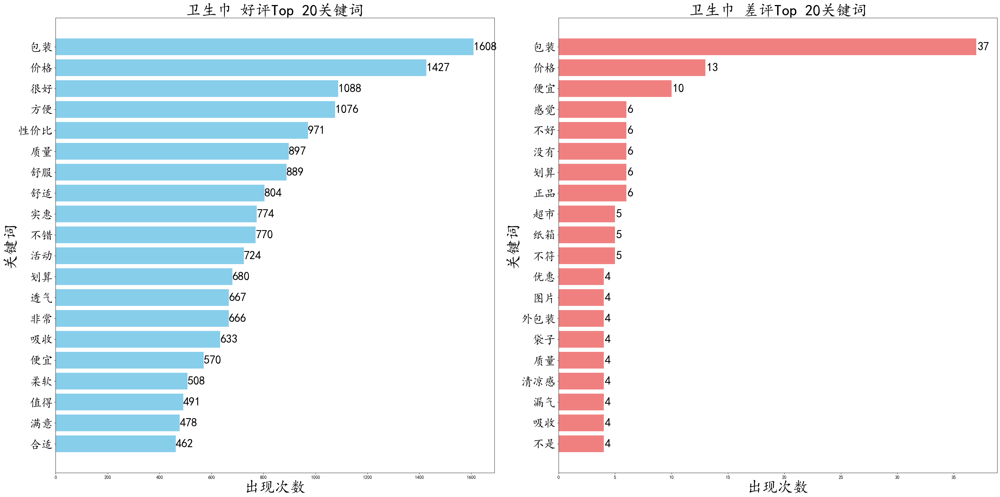

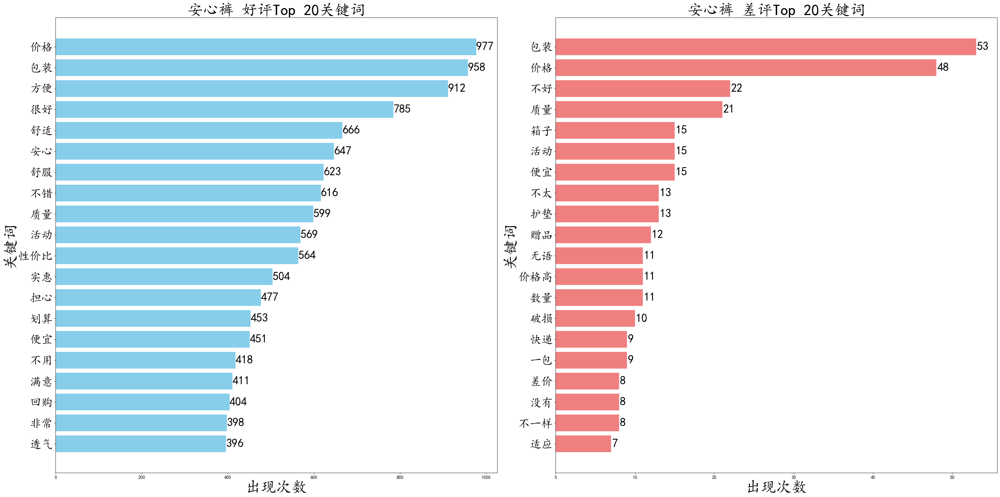

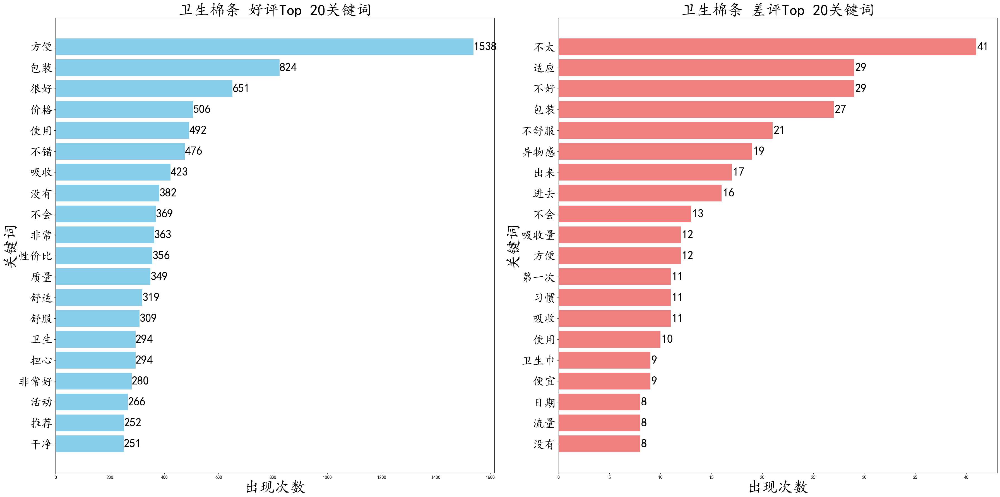

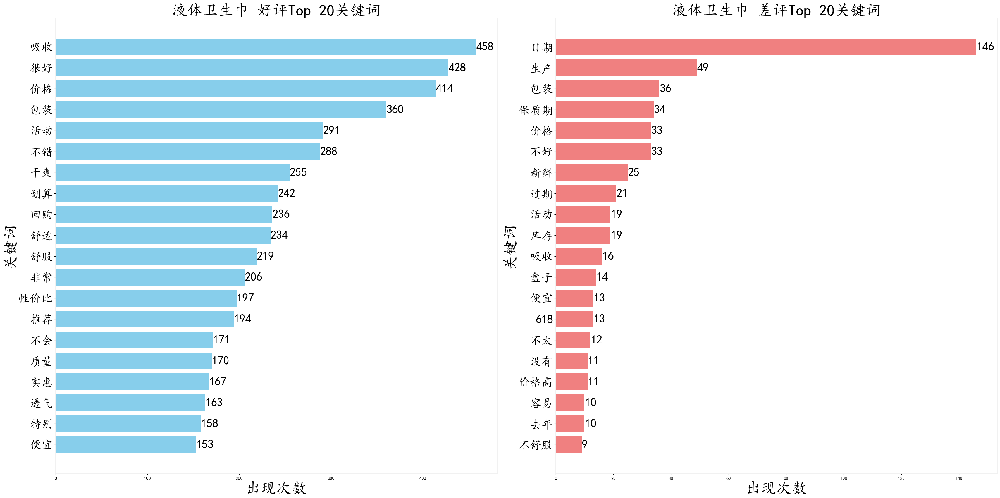

In [48]:
# 按品牌大类划分数据，并绘制Top 10关键词柱状图
from collections import Counter

category_list = df['品牌大类'].unique()

# 设定字体路径
font_path = 'C:/Windows/Fonts/simkai.ttf'  # 请将路径替换为你本地的字体路径

for category in category_list:
    # 筛选出该类别的数据
    df_category = df[df['品牌大类'] == category]

    # 高星评论
    high_rating_words = df_category[df_category['情感评分'] >= 4]['关键词列表'].sum()
    high_rating_words = [word for word in high_rating_words if len(word) >= 2]

    # 差评评论
    low_rating_words = df_category[df_category['情感评分'] <= 2]['关键词列表'].sum()
    low_rating_words = [word for word in low_rating_words if len(word) >= 2]

    # 统计词频并获取Top 10关键词
    high_rating_top10 = Counter(high_rating_words).most_common(20)
    low_rating_top10 = Counter(low_rating_words).most_common(20)

    # 绘制Top 10关键词柱状图
    plt.figure(figsize=(36, 18))

    # 高星Top 10关键词
    plt.subplot(1, 2, 1)
    words, counts = zip(*high_rating_top10)
    bars = plt.barh(words, counts, color='skyblue')
    plt.title(f'{category} 好评Top 20关键词', fontsize=40)
    plt.xlabel('出现次数', fontsize=40)
    plt.ylabel('关键词', fontsize=40)
    plt.gca().invert_yaxis()  # 关键词顺序从上到下排列

    # 添加出现次数的数字标签
    for bar in bars:
        plt.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height()/2,
                 f'{int(bar.get_width())}', va='center', ha='left', fontsize=30)

    # 调整关键字字体大小
    for tick in plt.gca().get_yticklabels():
        tick.set_fontsize(30)  # 将关键字字体大小设置为30

    # 差评Top 10关键词
    plt.subplot(1, 2, 2)
    words, counts = zip(*low_rating_top10)
    bars = plt.barh(words, counts, color='lightcoral')
    plt.title(f'{category} 差评Top 20关键词', fontsize=40)
    plt.xlabel('出现次数', fontsize=40)
    plt.ylabel('关键词', fontsize=40)
    plt.gca().invert_yaxis()  # 关键词顺序从上到下排列

    # 添加出现次数的数字标签
    for bar in bars:
        plt.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height()/2,
                 f'{int(bar.get_width())}', va='center', ha='left', fontsize=30)

    # 调整关键字字体大小
    for tick in plt.gca().get_yticklabels():
        tick.set_fontsize(30)  # 将关键字字体大小设置为30

    # 显示图像
    plt.tight_layout()
    plt.show()

In [49]:
df.head(10)

,Unnamed: 0,评价时间,评价内容,来源平台,页面标题,品牌名称,品牌大类,评论字数,输出结果,产品质量关键词,使用体验关键词,包装关键词,价格关键词,情感评分,time,关键词列表
0,0,2024-08-02,十几年一直用abc，薄的很舒服，比任何牌子都透气。,淘宝,ABC卫生巾,ABC,卫生巾,25,\n#### 输入:\n**产品类别**: 卫生巾\n**评论**: “十几年一直用abc，...,薄、透气,舒服,无,无,5,2024-08-02,"[薄, 透气, 舒服, 无, 无]"
1,1,2024-05-29,"ABC最出名的就是它的清凉经典配方,温和 健康，呵护肌肤的同时，还能赶走姨妈期的 闷热，带来...",淘宝,ABC卫生巾,ABC,卫生巾,87,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉经典配方、温和、健康、...,清凉经典配方、温和、健康、呵护肌肤、赶走闷热、舒爽、通透,不习惯、真的香、轻透,无,无,5,2024-05-29,"[清凉, 经典, 配方, 温和, 健康, 呵护, 肌肤, 赶走, 闷热, 舒爽, 通透, 不..."
2,2,2024-07-31,ABC卫生巾真的是女生的小贴心❤️，用起来超级舒服，不闷不热，吸收力超强！量大也不怕，完全不...,淘宝,ABC卫生巾,ABC,卫生巾,81,\n1. **关键词提取与归类**:\n - 产品质量相关: 吸收力超强、量大、不侧漏\...,吸收力超强、量大、不侧漏,超级舒服、不闷不热、稳稳的、幸福感爆棚,无,无,5,2024-07-31,"[吸收, 力, 超强, 量, 大, 不, 侧, 漏, 超级, 舒服, 不, 闷, 不, 热,..."
3,3,2024-06-28,夏天用ABC的可以清凉一点吧。,淘宝,ABC卫生巾,ABC,卫生巾,15,\n1. **关键词提取与归类**:\n - 产品质量相关: 清凉\n - 使用体验...,清凉,无,无,无,3,2024-06-28,"[清凉, 无, 无, 无]"
4,4,2024-05-27,好评好评，物流快服务好，天猫超市买东西就是好用。,淘宝,ABC卫生巾,ABC,卫生巾,24,\n### 输入:\n**产品类别**: 卫生巾\n**评论**: “好评好评，物流快服务好...,无,天猫超市买东西好用,无,无,5,2024-05-27,"[无, 天猫超市, 买东西, 好, 用, 无, 无]"
5,5,2024-06-07,最爱用的卫生巾 好用,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 好用\n - 使用体验...,好用,[无相关关键词],[无相关关键词],[无相关关键词],5,2024-06-07,"[好, 用, [, 无, 相关, 关键词, ], [, 无, 相关, 关键词, ], [, ..."
6,6,2024-08-03,一直用的一款一直回购,淘宝,ABC卫生巾,ABC,卫生巾,10,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,一直用、回购,无,无,5,2024-08-03,"[无, 一直, 用, 回购, 无, 无]"
7,7,2024-08-02,送货上门，购物方便，省去了去超市选购的时间。,淘宝,ABC卫生巾,ABC,卫生巾,22,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,购物方便、省时,无,无,4,2024-08-02,"[无, 购物, 方便, 省时, 无, 无]"
8,8,2024-07-30,东西质量非常好，与卖家描述的完全一致，非常满意,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 质量好、描述一致\n ...,质量好、描述一致,无,无,无,5,2024-07-30,"[质量好, 描述, 一致, 无, 无, 无]"
9,9,2024-07-29,半日达很方便 每次都能很及时收到 价格也很便宜,淘宝,ABC卫生巾,ABC,卫生巾,23,\n1. **关键词提取与归类**:\n - 产品质量相关: 无\n - 使用体验相...,无,半日达方便 及时,无,便宜,4,2024-07-29,"[无, 半日, 达, 方便, , 及时, 无, 便宜]"


In [50]:
df.to_excel("process.xlsx")